# Imports

In [34]:
import os
import torch
# import time
import cv2
import numpy as np
# import pandas as pd
from PIL import Image

# import torch.nn as nn
# from tqdm import tqdm
# import seaborn as sns
# import torch.optim as optim
import matplotlib.pyplot as plt
import torch.nn.functional as F
# from collections import Counter
# from torch.utils.data import Subset
from torchvision import datasets 
from torchvision import transforms 
# from torch.utils.data import DataLoader, Subset, random_split
# from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix


## UTILS

In [35]:
def plot_image(image, title_image="Imagem", cmap='gray'):
    # Converte de BGR para RGB se a imagem for colorida
    if len(image.shape) == 3:  # Imagem colorida
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    plt.imshow(image, cmap=cmap)
    plt.title(title_image)
    plt.axis('off')  # Oculta os eixos
    plt.show()


In [36]:
def plot_images(images, titles):
    """Plotar imagens lado a lado, independente da quantidade de imagens."""
    
    n = len(images)
    cols = n  # O número de colunas será igual ao número de imagens
    rows = 1  # Colocando todas as imagens em uma única linha
    
    fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(5 * n, 5))
    
    # Se o número de imagens for 1, axes será um único objeto, então transformamos em uma lista para garantir que sempre será indexável
    if n == 1:
        axes = [axes]
    
    for i, (img, title) in enumerate(zip(images, titles)):
        axes[i].imshow(img, cmap="gray")
        axes[i].set_title(title)
        axes[i].axis("off")  # Desabilitar os eixos
    
    plt.tight_layout()
    plt.show()


In [37]:
def is_grayscale_rgb(image: Image.Image) -> bool:
    # Converter imagem para array NumPy
    img_array = np.array(image)
    
    # Verificar se a imagem é RGB
    if img_array.ndim == 3 and img_array.shape[2] == 3:
        # Comparar os canais R, G e B
        return np.all(img_array[..., 0] == img_array[..., 1]) and np.all(img_array[..., 1] == img_array[..., 2])
    return False

In [38]:
def show_image_and_histogram(img, title_image="Image", title_hist="Histogram", bins=256):
    # plotar imagem de um lado e do outro o histograma
    plt.figure(figsize=(15, 5))

    # Adicionar a imagem
    plt.subplot(1, 2, 1)
    plt.imshow(img, cmap="gray")
    plt.title(title_image)
    plt.axis("off")

    # Adicionar o histograma da imagem
    plt.subplot(1, 2, 2)
    plt.hist(np.array(img).ravel(), bins=bins, color="black")
    plt.title(title_hist)
    plt.xlabel("Pixel Value")
    plt.ylabel("Frequency")

    plt.tight_layout()
    plt.show()

In [39]:
train_path = os.path.normpath(r'/kaggle/input/kermany2018/OCT2017 /train')
test_path = os.path.normpath(r'/kaggle/input/kermany2018/OCT2017 /test')
val_path = os.path.normpath(r'/kaggle/input/kermany2018/OCT2017 /val')

if os.name == 'nt':
    print("Windows doesn't like spaces at the end of directories")
    train_path = train_path.replace(' ', '')
    test_path = test_path.replace(' ', '')
    val_path = val_path.replace(' ', '')
    
    train_path = os.getcwd() + train_path
    test_path = os.getcwd() + test_path
    val_path = os.getcwd() + val_path

print(train_path)
print(test_path)
print(val_path)
dataset_path = train_path

Windows doesn't like spaces at the end of directories
c:\Users\mylle\OneDrive\Área de Trabalho\temp pdi project\kaggle\input\kermany2018\OCT2017\train
c:\Users\mylle\OneDrive\Área de Trabalho\temp pdi project\kaggle\input\kermany2018\OCT2017\test
c:\Users\mylle\OneDrive\Área de Trabalho\temp pdi project\kaggle\input\kermany2018\OCT2017\val


In [40]:
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cpu'

In [41]:
dataset = datasets.ImageFolder(dataset_path)
print(f"Number of samples in the dataset: {len(dataset)}")

Number of samples in the dataset: 83484


# Analysis

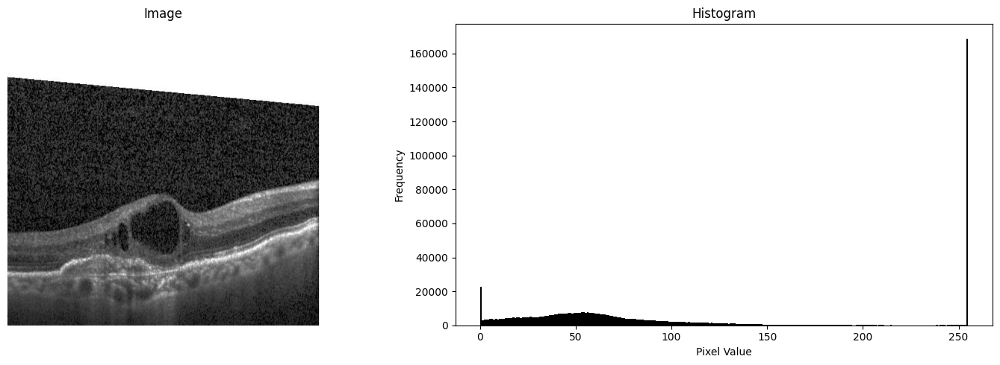

In [42]:
index = 10
img, label = dataset[index]
show_image_and_histogram(img, title_image="Image", title_hist="Histogram", bins=256)

In [43]:
mean, std = 0.18484567, 0.15903676

## Resize

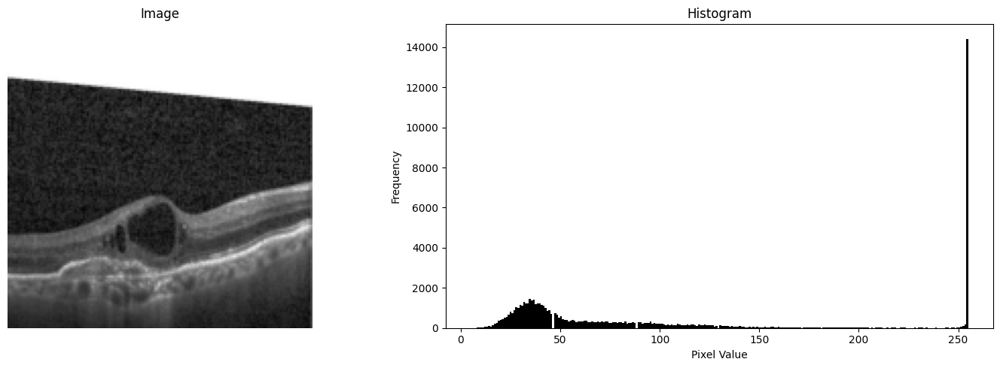

In [44]:
T = transforms.Compose([transforms.Resize((150, 150))])

show_image_and_histogram(T(img), title_image="Image", title_hist="Histogram", bins=256)

## Resize e CenterCrop

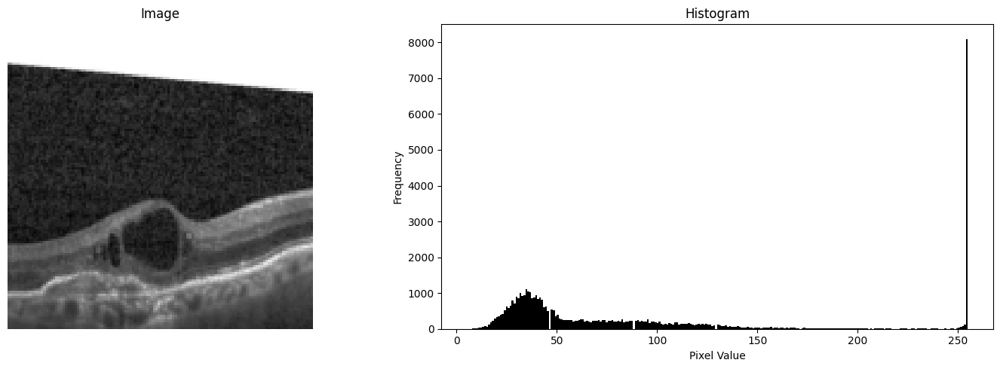

In [45]:
T = transforms.Compose([
    transforms.Resize((150, 150)),
    transforms.CenterCrop((128, 128))
    ])

show_image_and_histogram(T(img), title_image="Image", title_hist="Histogram", bins=256)

# Preprocessing 

In [46]:
T = transforms.Compose([
    transforms.Resize((150, 150)),
    transforms.CenterCrop((128, 128)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[mean] * 3, std=[std] * 3),
    ])
print(T(img))


tensor([[[ 5.1256e+00,  5.1256e+00,  5.1256e+00,  ...,  5.1256e+00,
           5.1256e+00,  5.1256e+00],
         [ 5.1256e+00,  5.1256e+00,  5.1256e+00,  ...,  5.1256e+00,
           5.1256e+00,  5.1256e+00],
         [ 5.1256e+00,  5.1256e+00,  5.1256e+00,  ...,  5.1256e+00,
           5.1256e+00,  5.1256e+00],
         ...,
         [ 4.6516e-01,  4.6516e-01,  3.9119e-01,  ..., -1.2664e-01,
          -1.7595e-01, -5.2661e-02],
         [ 4.1585e-01,  3.9119e-01,  3.9119e-01,  ..., -2.2527e-01,
          -1.0198e-01, -3.3448e-03],
         [ 3.9119e-01,  3.9119e-01,  3.1721e-01,  ..., -2.0061e-01,
          -1.7595e-01, -2.4993e-01]],

        [[ 5.1256e+00,  5.1256e+00,  5.1256e+00,  ...,  5.1256e+00,
           5.1256e+00,  5.1256e+00],
         [ 5.1256e+00,  5.1256e+00,  5.1256e+00,  ...,  5.1256e+00,
           5.1256e+00,  5.1256e+00],
         [ 5.1256e+00,  5.1256e+00,  5.1256e+00,  ...,  5.1256e+00,
           5.1256e+00,  5.1256e+00],
         ...,
         [ 4.6516e-01,  4

## Median filter

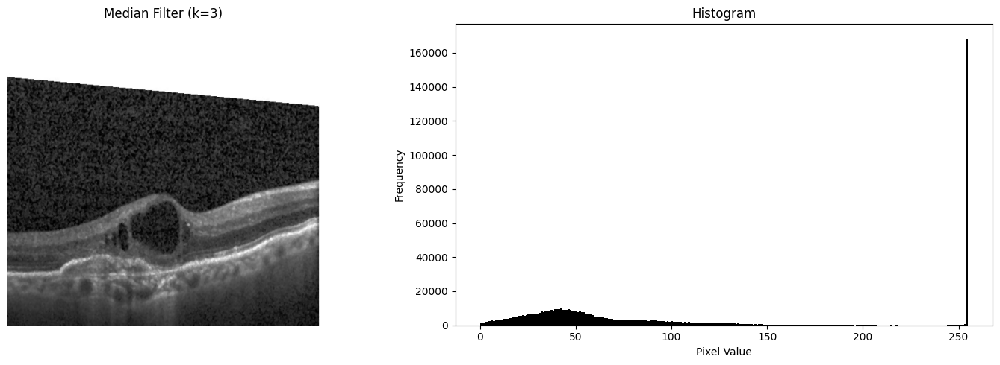

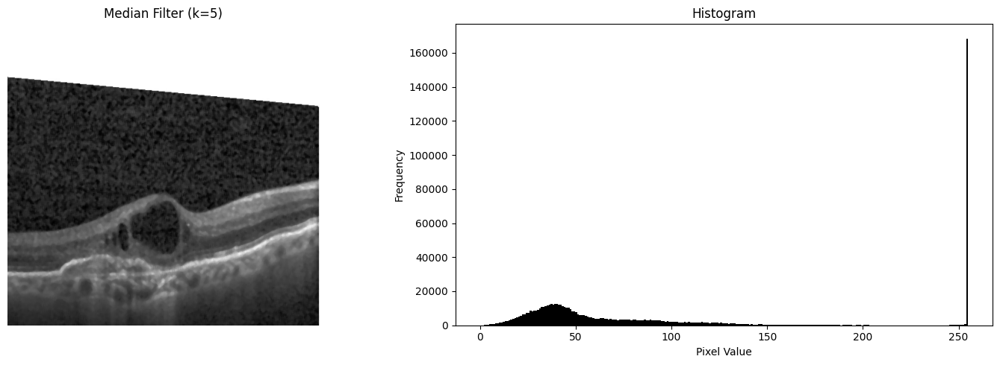

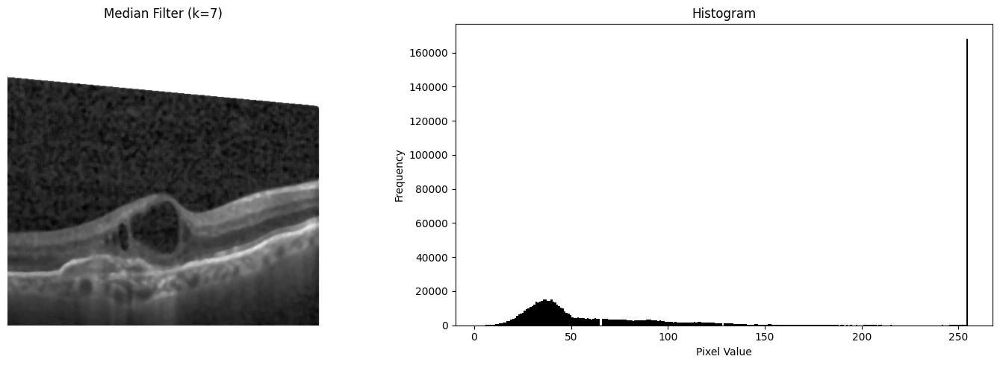

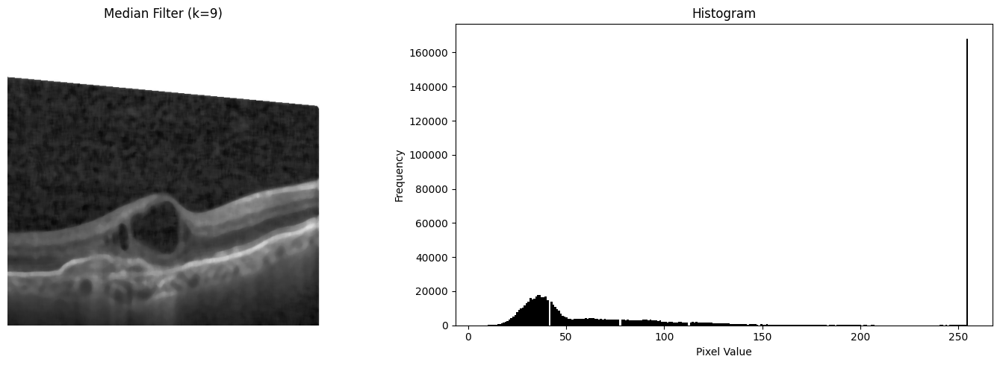

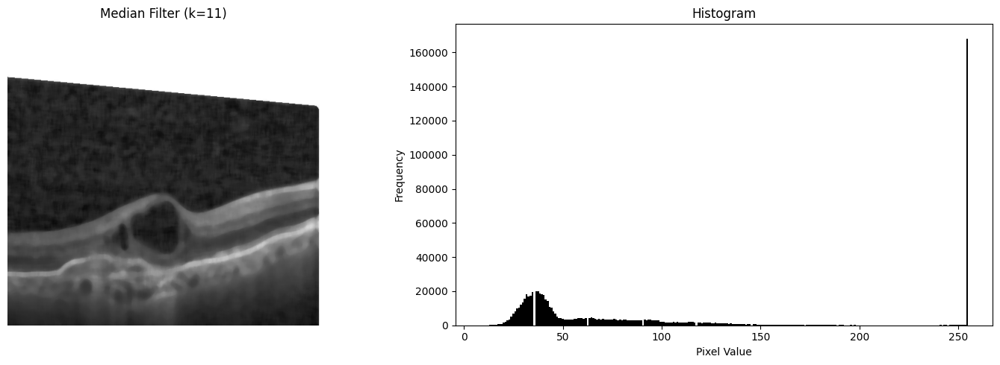

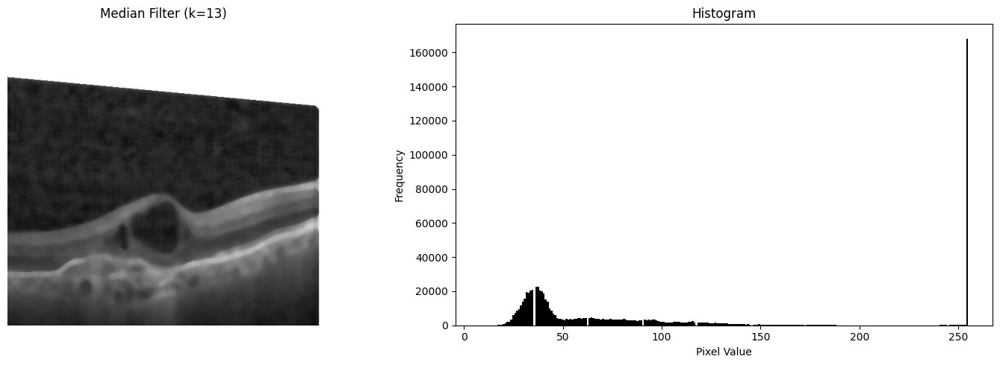

In [47]:
def median_filter(image, ksize: int = 5) -> Image:
    return Image.fromarray(cv2.medianBlur(np.array(image), ksize=ksize))


ksizes = [3, 5, 7, 9, 11, 13]

for k in ksizes:
    show_image_and_histogram(median_filter(img, ksize=k), title_image=f"Median Filter (k={k})", title_hist="Histogram", bins=256)

## CLAHE

#### Observação
O artigo não fala sobre os parametros(clipLimit e tileGridSize) utilizados no Algoritmo CLAHE.

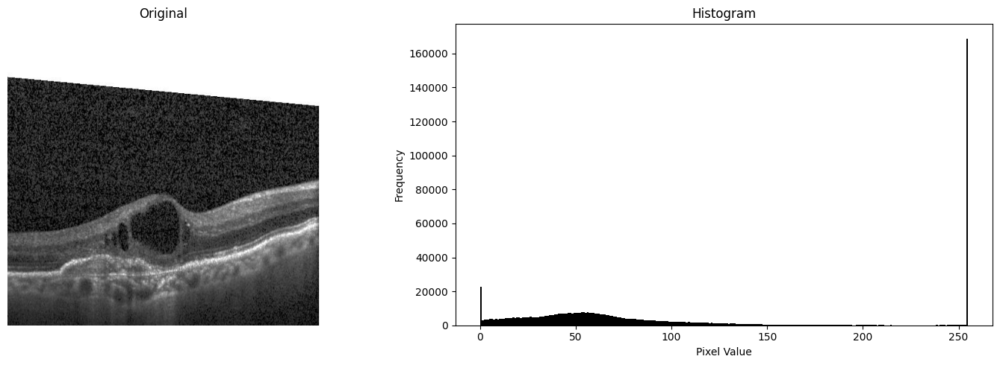

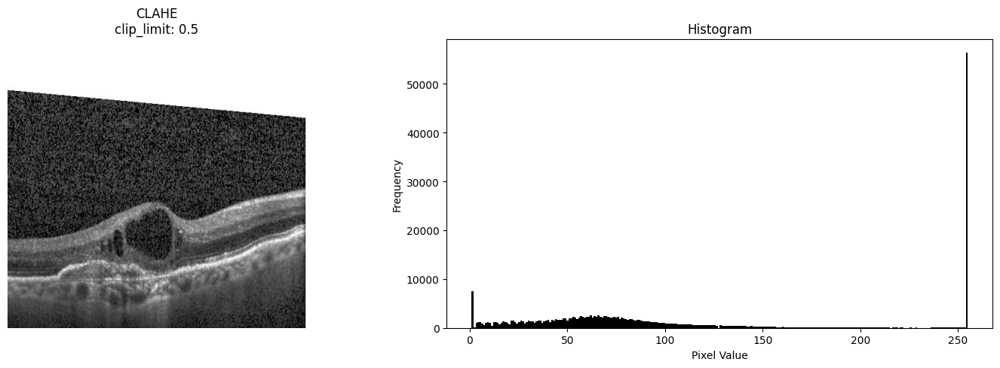

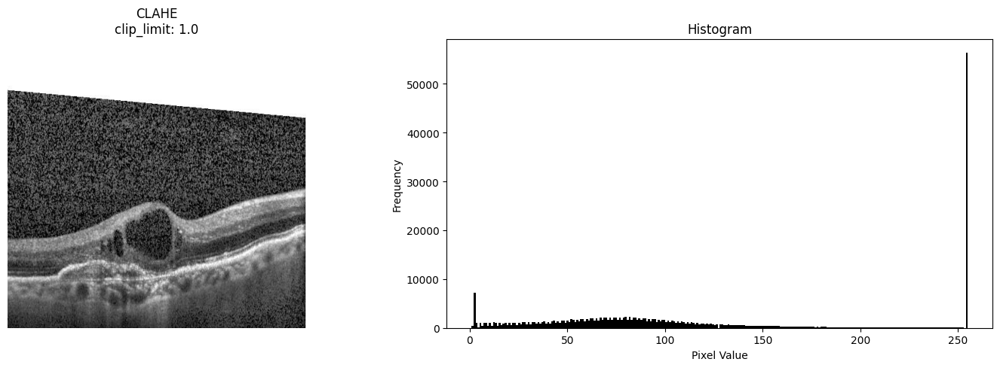

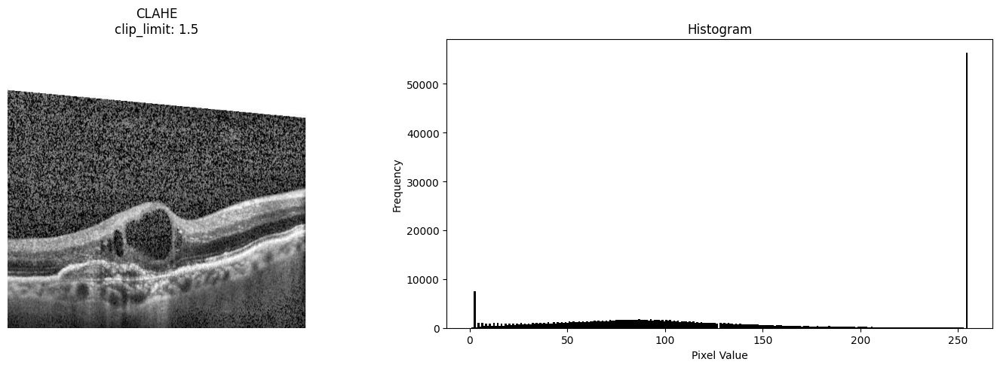

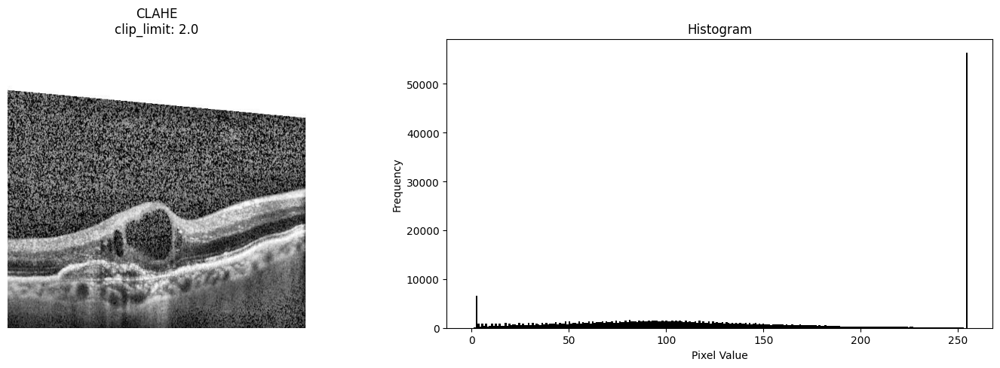

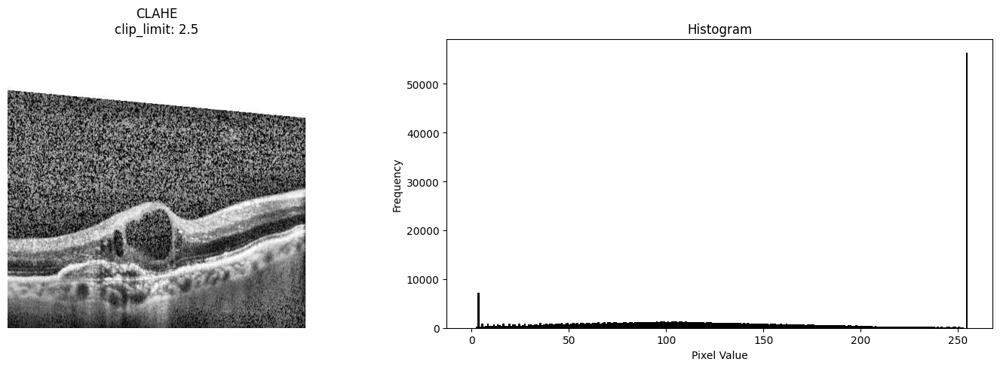

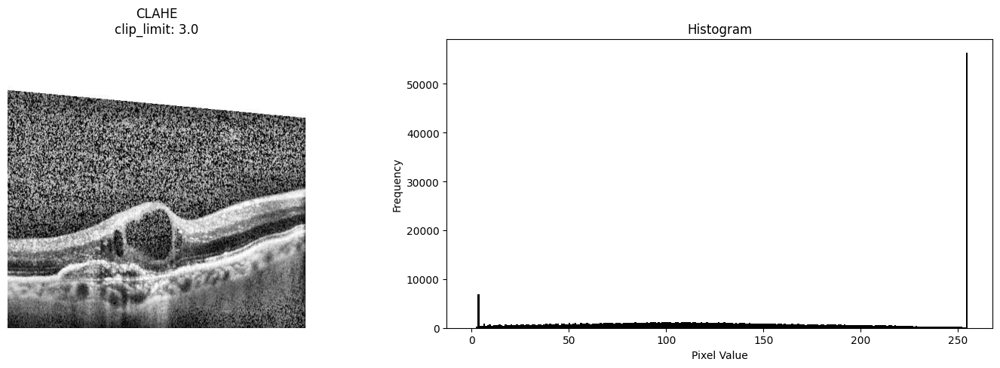

In [48]:
def clahe(image, clip_limit=2.0, tile_grid_size=(8, 8)):
    gray_image = cv2.cvtColor(np.array(image), cv2.COLOR_RGB2GRAY) if len(np.array(image).shape) == 3 else np.array(image)
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)
    return Image.fromarray(clahe.apply(gray_image))


show_image_and_histogram(img, title_image="Original", title_hist="Histogram", bins=256)
# clip_limit = 2.0
tile_grid_size = (8, 8)

clips = [0.5, 1.0, 1.5, 2.0, 2.5, 3.0]
for clip in clips:
    temp = clahe(img, clip_limit=clip, tile_grid_size=tile_grid_size)
    show_image_and_histogram(temp, title_image=f"CLAHE\nclip_limit: {clip}", title_hist="Histogram", bins=256)
    

## Segmentation

### Otsu

In [49]:
def otsu(image):
    gray_image = cv2.cvtColor(np.array(image), cv2.COLOR_RGB2GRAY) if len(np.array(image).shape) == 3 else np.array(image)
    threshold, otsu = cv2.threshold(np.array(gray_image), 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    return Image.fromarray(otsu)

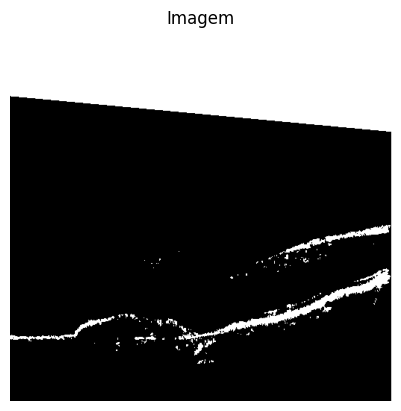

In [50]:
plot_image(np.array(otsu(img)))

### Iterative 

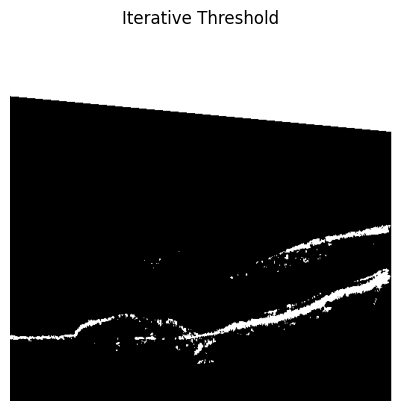

In [51]:
def iterative_threshold(image, delta=0.1):
    image = np.array(image)
    threshold = np.mean(image)
    while True:
        group1, group2 = image[image > threshold], image[image <= threshold]
        m1 = np.mean(group1) if len(group1) > 0 else 0
        m2 = np.mean(group2) if len(group2) > 0 else 0
        new_threshold = (m1 + m2) / 2
        if abs(threshold - new_threshold) < delta:
            return new_threshold
        threshold = new_threshold

# segmentar a imagem com o threshold obtido pelo método iterativo
threshold = int(iterative_threshold(img, delta=0.1))
thresholded = (np.array(img) > threshold).astype(np.uint8) * 255  

plot_image(thresholded, title_image="Iterative Threshold")

### PIPE

Clip Limit: 0.5


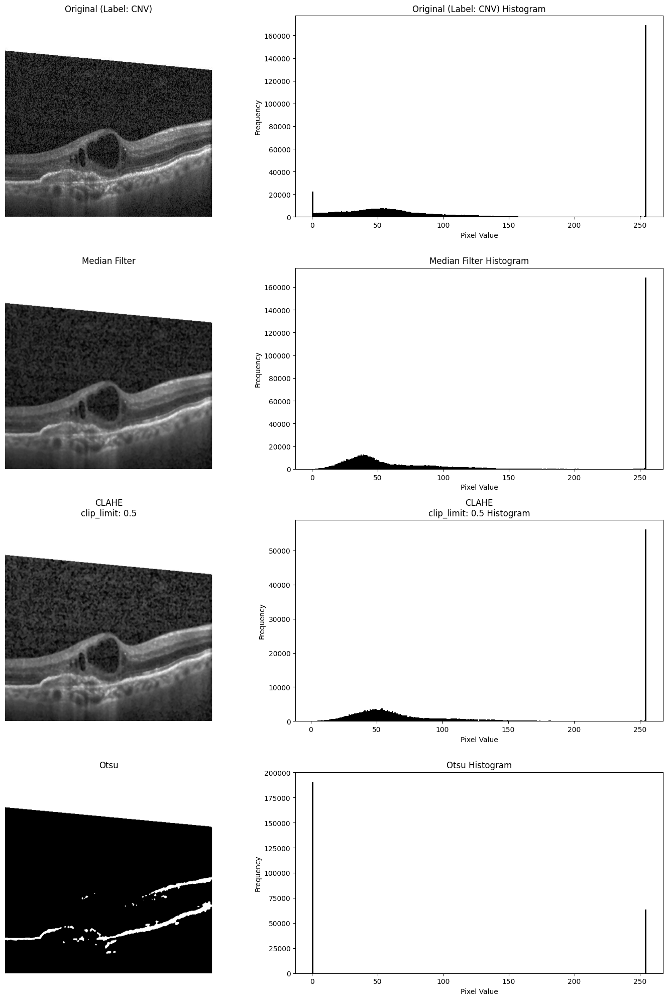

*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-
Clip Limit: 1.0


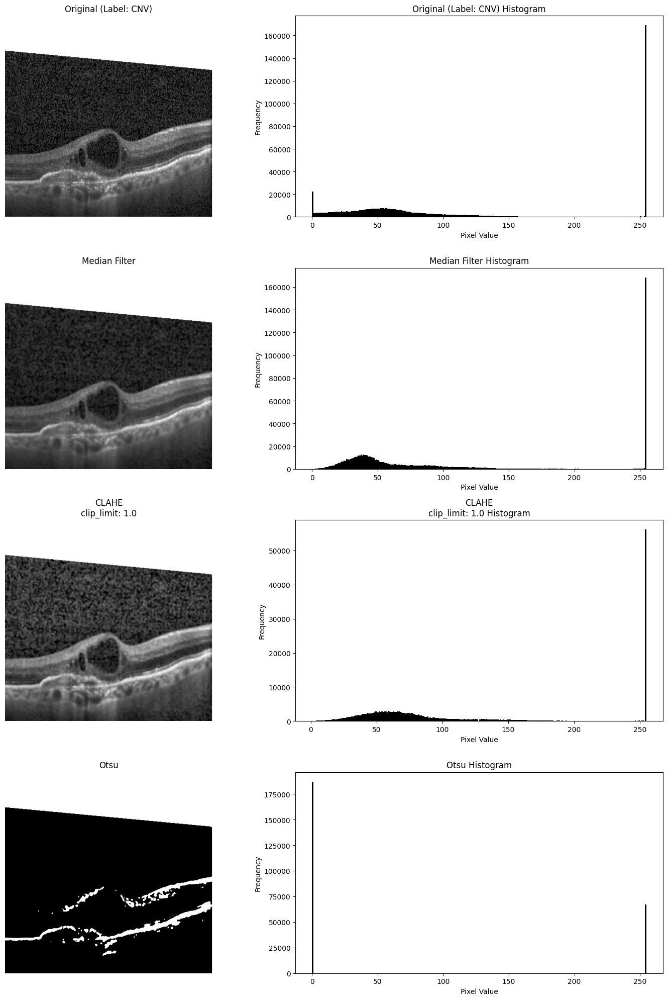

*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-
Clip Limit: 1.5


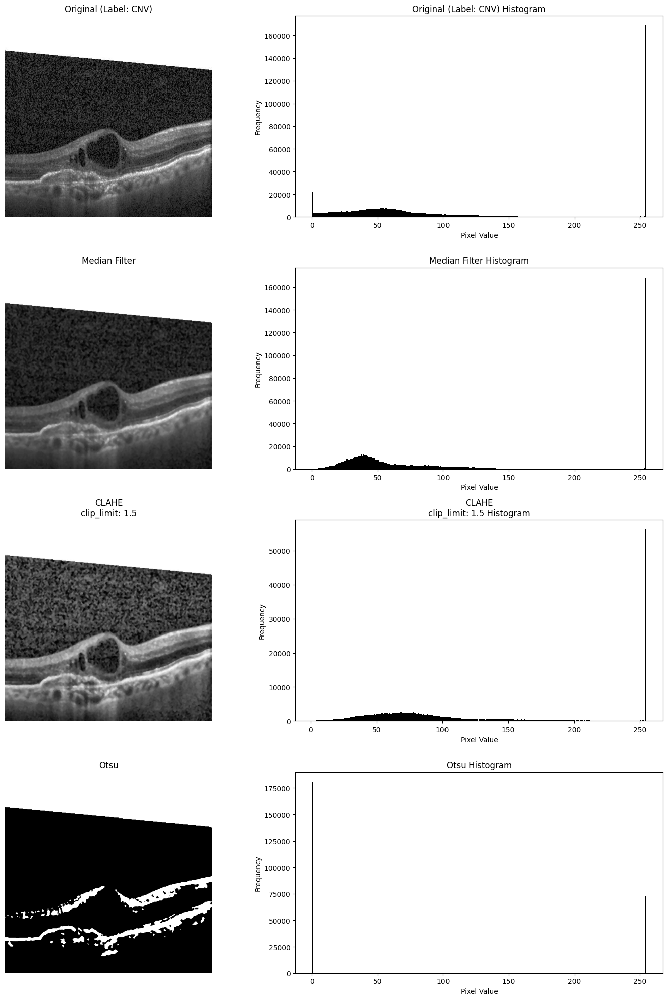

*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-
Clip Limit: 2.0


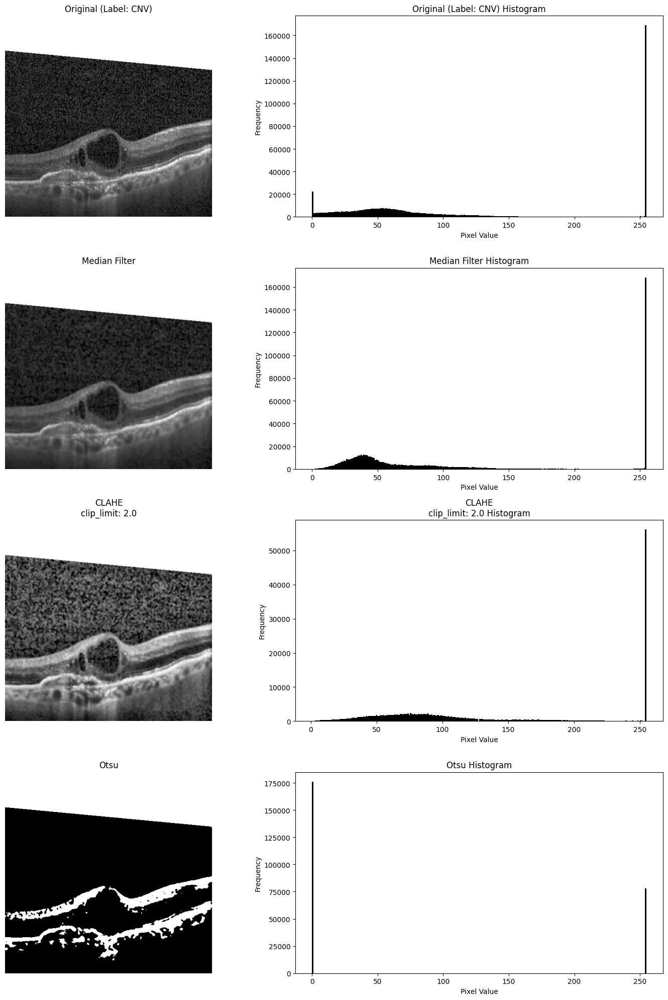

*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-
Clip Limit: 2.5


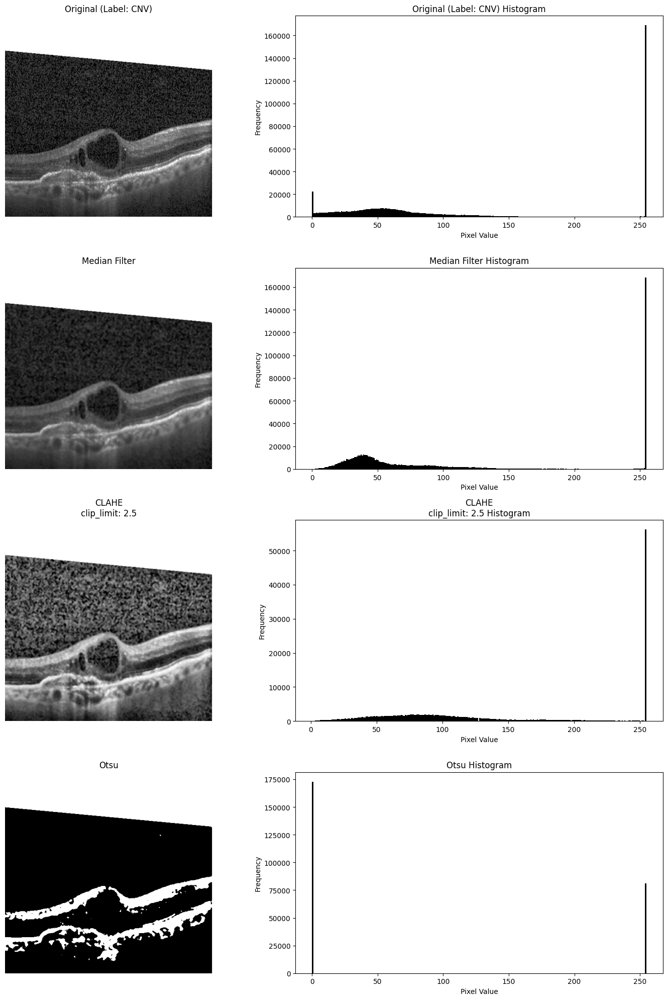

*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-
Clip Limit: 3.0


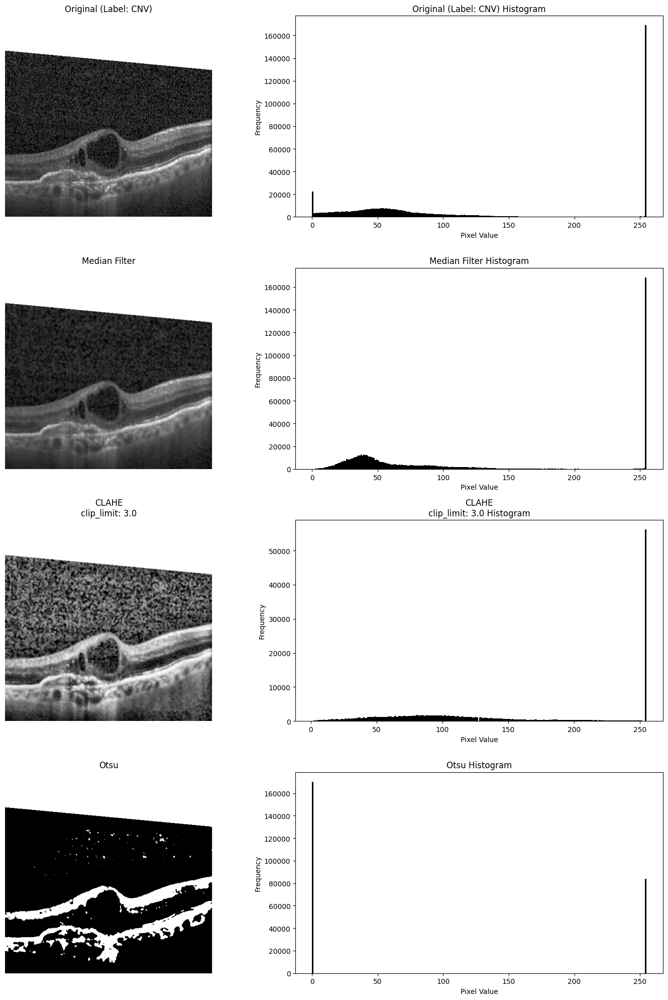

*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-
Clip Limit: 3.5


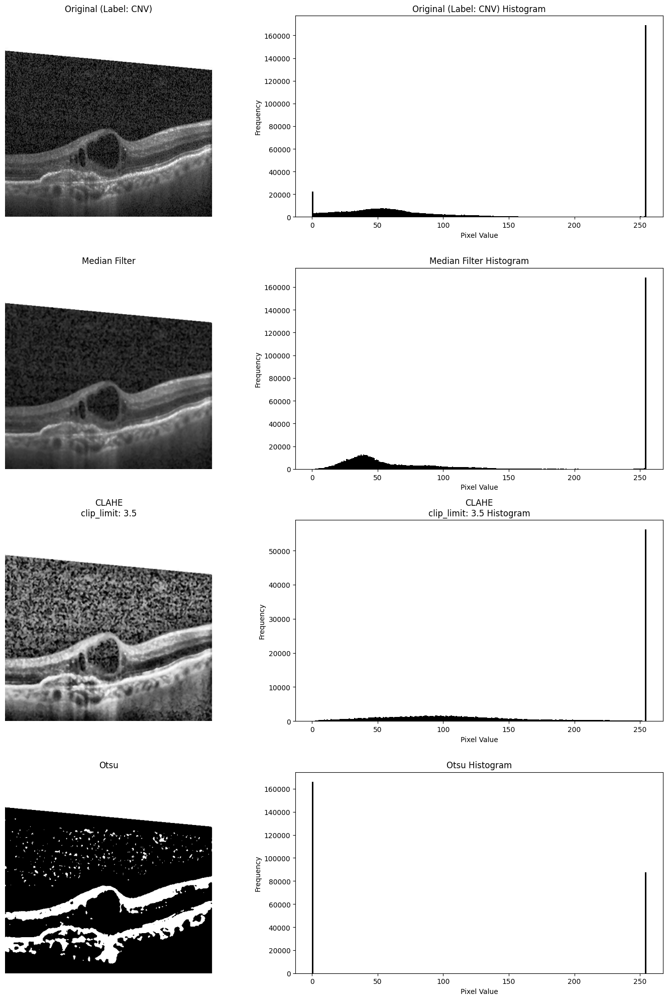

*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-


In [52]:
def plot_images_with_histograms(images, titles):
    """Plotar imagens e seus histogramas."""
    n = len(images)
    fig, axes = plt.subplots(nrows=n, ncols=2, figsize=(15, 5 * n))
    
    # Garantir que axes sempre seja uma lista para consistência
    if n == 1:
        axes = [axes]
    
    # for i, img in enumerate(images):
    for i, (img, title) in enumerate(zip(images, titles)):
        # Plotar a imagem
        axes[i][0].imshow(img, cmap="gray")
        axes[i][0].set_title(title)
        axes[i][0].axis("off")

        # Plotar o histograma
        axes[i][1].hist(np.array(img).ravel(), bins=256, color="black")
        axes[i][1].set_title(f"{title} Histogram")
        axes[i][1].set_xlabel("Pixel Value")
        axes[i][1].set_ylabel("Frequency")

    plt.tight_layout()
    plt.show()


def pipe(image, clip_limit=2.0):
    images, titles = [], []
    
    image = median_filter(image)
    images.append(image.copy())
    titles.append("Median Filter")

    image = clahe(image, clip_limit=clip_limit)
    images.append(image.copy())
    titles.append(f"CLAHE\nclip_limit: {clip_limit}")
    

    image = otsu(image)
    images.append(image.copy())
    titles.append("Otsu")

    return images, ["Median Filter", f"CLAHE\nclip_limit: {clip_limit}", "Otsu"]


clips = [0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5]
# index = 10
# img, label = dataset[index]
for clip in clips:
    clip_limit = clip
    print(f"Clip Limit: {clip_limit}")

    images, titles = pipe(img, clip_limit=clip_limit)
    images.insert(0, img)
    titles.insert(0, f"Original (Label: {dataset.classes[label]})")
    
    plot_images_with_histograms(images, titles)
    print("*-" * 50)

OBS: Nota-se que com clip_limit acima de 2.0 a segmentação começa a incluir ruídos.

Como o artigo não define os parâmetros do CLAHE, iremos utilizar 2.0.

## Morphology operations

### All operations

In [54]:
erode = lambda x, k: cv2.erode(x, k, iterations=1)
dilate = lambda x, k: cv2.dilate(x, k, iterations=1)
open = lambda x, k: cv2.morphologyEx(x, cv2.MORPH_OPEN, k, iterations=1)
close = lambda x, k: cv2.morphologyEx(x, cv2.MORPH_CLOSE, k, iterations=1)
gradient = lambda x, k: cv2.morphologyEx(x, cv2.MORPH_GRADIENT, k, iterations=1)
tophat = lambda x, k: cv2.morphologyEx(x, cv2.MORPH_TOPHAT, k, iterations=1)
blackhat = lambda x, k: cv2.morphologyEx(x, cv2.MORPH_BLACKHAT, k, iterations=1)


def morphological_smoothing(
    x: np.ndarray,
    k: np.ndarray = cv2.getStructuringElement(cv2.MORPH_RECT, (5, 5)),
    iterations: int = 1,
):
    x = cv2.morphologyEx(x, cv2.MORPH_OPEN, k, iterations=iterations)
    x = cv2.morphologyEx(x, cv2.MORPH_CLOSE, k, iterations=iterations)
    return Image.fromarray(x)


def pipe(
    image,
    clip_limit=2.0,
    morph={
        "type": erode,
        "title": "Eroded",
        "kernel": cv2.getStructuringElement(cv2.MORPH_RECT, (5, 5)),
    },
):
    images, titles = [], []

    image = median_filter(image)
    images.append(image.copy())
    titles.append("Median Filter")

    image = clahe(image, clip_limit=clip_limit)
    images.append(image.copy())
    titles.append(f"CLAHE\nclip_limit: {clip_limit}")

    image = otsu(image)
    images.append(image.copy())
    titles.append("Otsu")

    image = morph["type"](x=np.array(image), k=morph["kernel"])
    images.append(image.copy())
    titles.append(morph["title"])

    return images, titles


operations = {
    "Eroded": erode,
    "Dilated": dilate,
    "Opened": open,
    "Closed": close,
    "Gradient": gradient,
    "Top Hat": tophat,
    "Black Hat": blackhat,
    "Morphological Smoothing": morphological_smoothing,
}


### ES: cv2.MORPH_RECT

#### 3x3

[[1 1 1]
 [1 1 1]
 [1 1 1]]


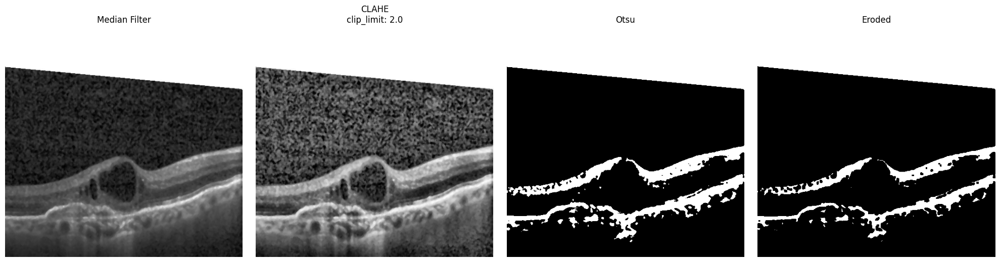

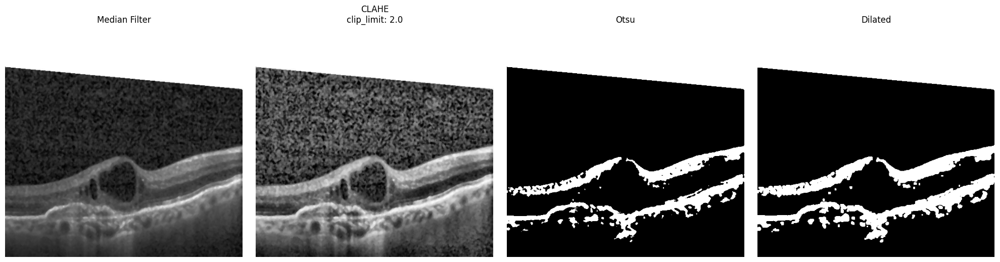

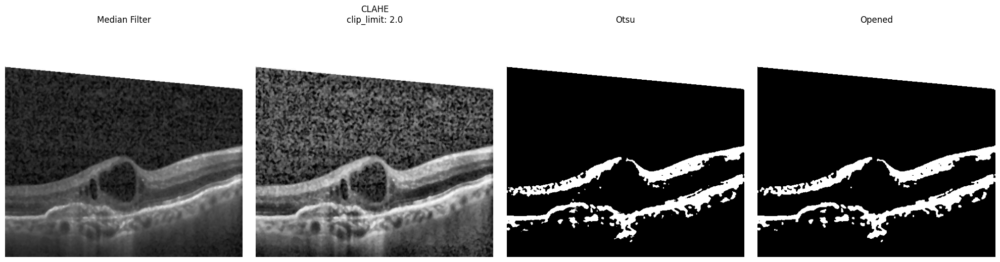

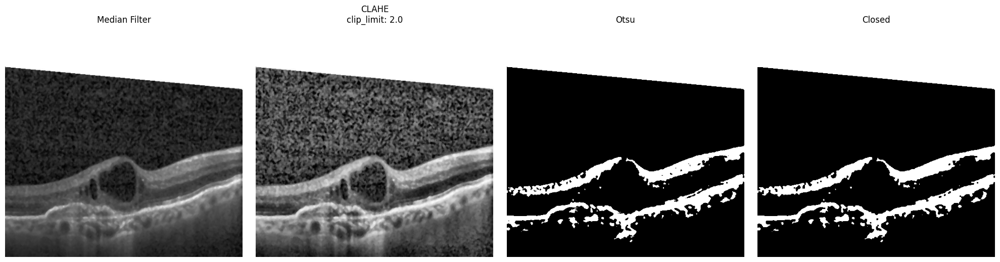

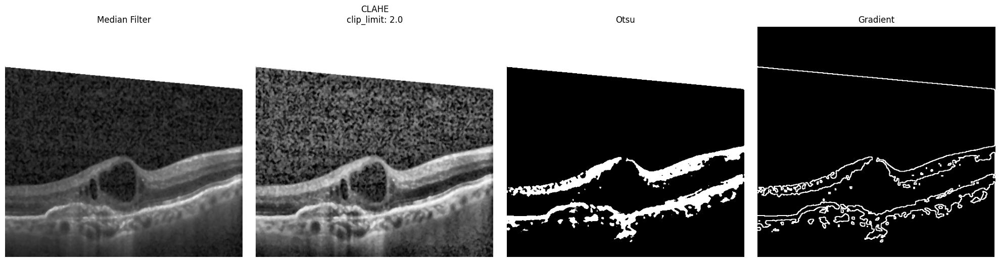

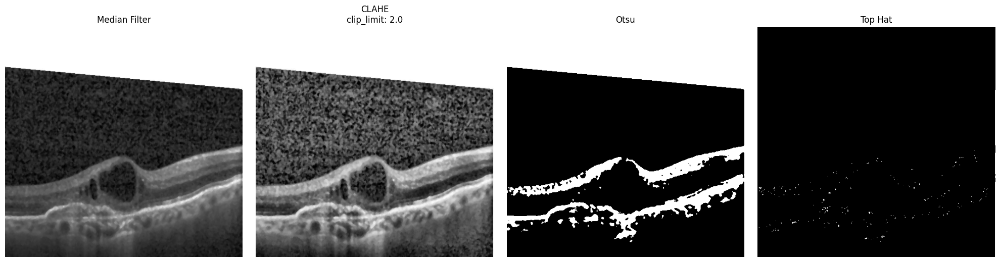

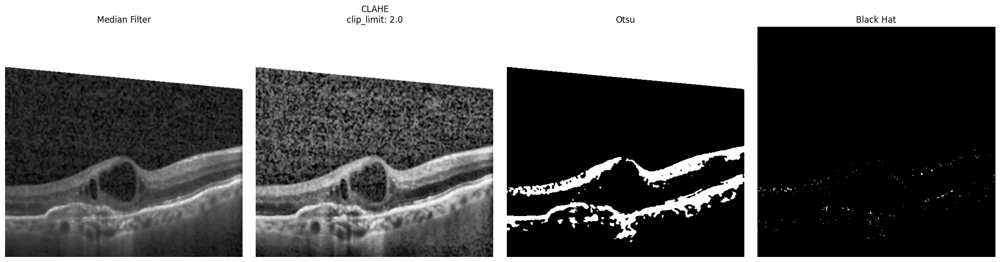

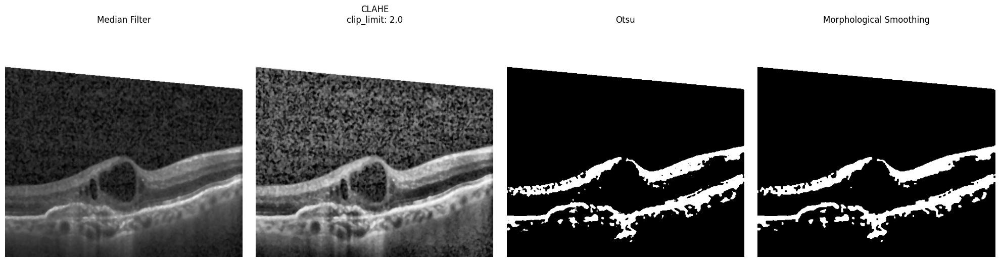

In [55]:
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
print(kernel)
for operation, op in operations.items():
    images, titles = pipe(
        img,
        clip_limit=2.0,
        morph={"type": op, "title": operation, "kernel": kernel},
    )
    plot_images(images, titles)

#### 5x5

[[1 1 1 1 1]
 [1 1 1 1 1]
 [1 1 1 1 1]
 [1 1 1 1 1]
 [1 1 1 1 1]]


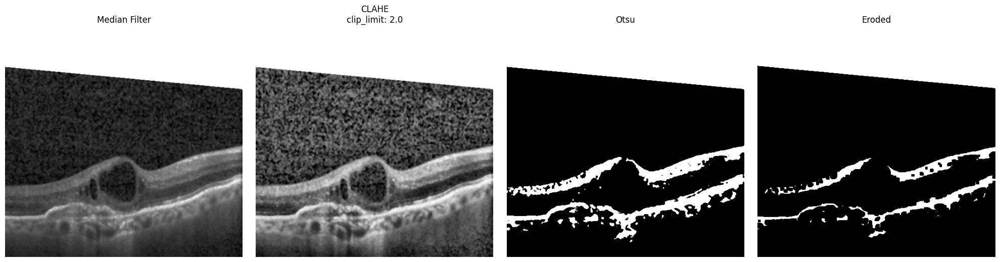

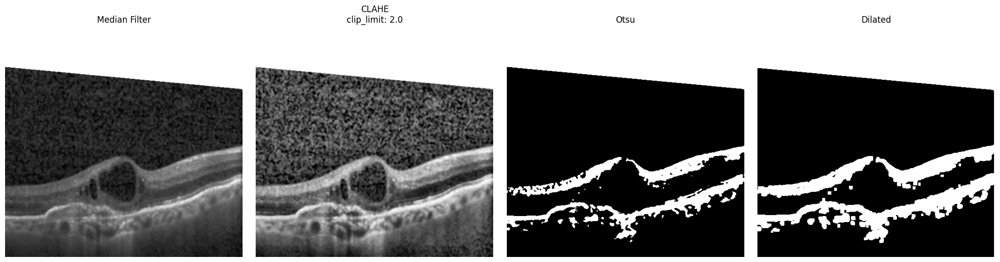

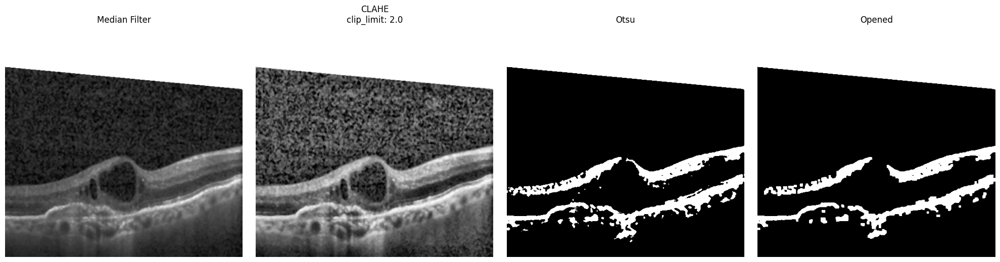

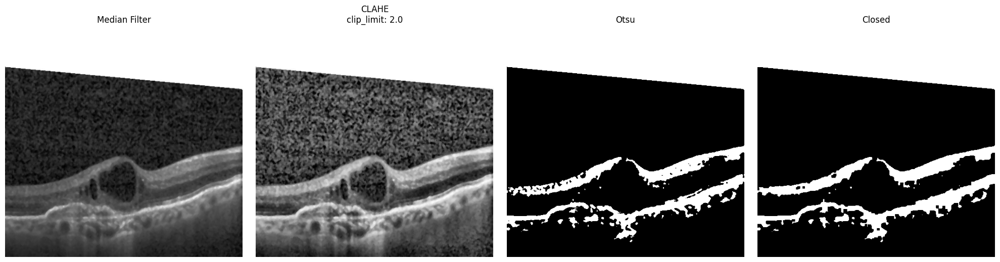

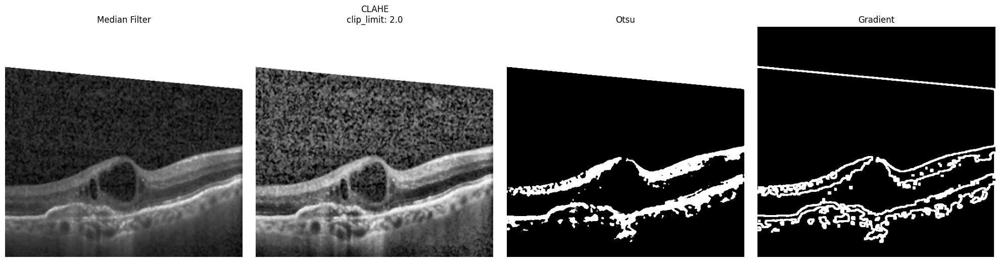

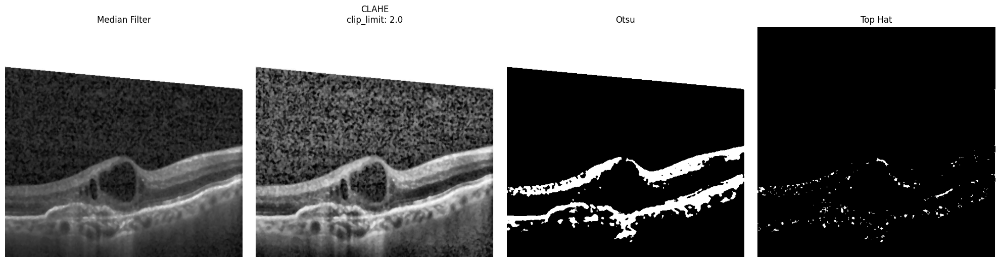

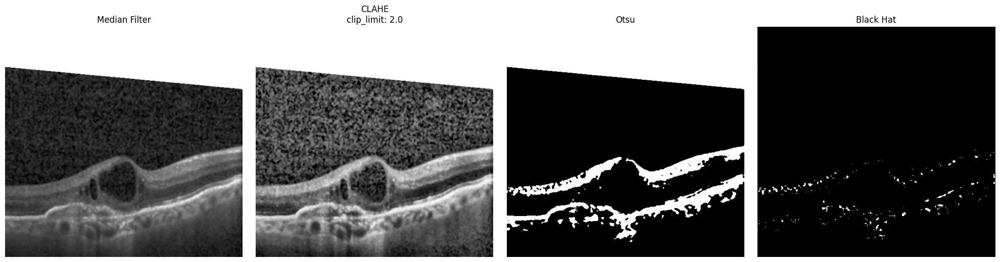

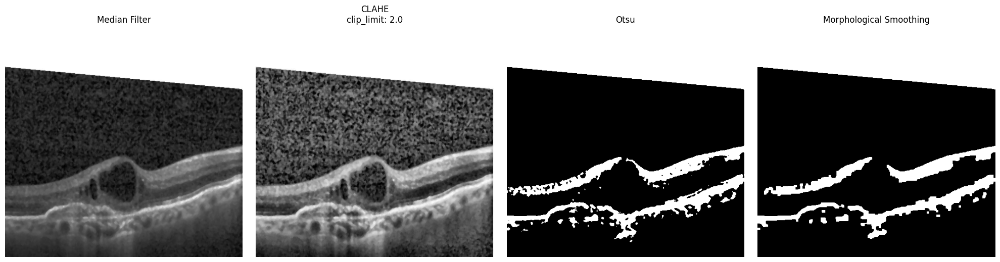

In [56]:
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5, 5))
print(kernel)
for operation, op in operations.items():
    images, titles = pipe(
        img,
        clip_limit=2.0,
        morph={"type": op, "title": operation, "kernel": kernel},
    )
    plot_images(images, titles)

#### 7x7

[[1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1]]


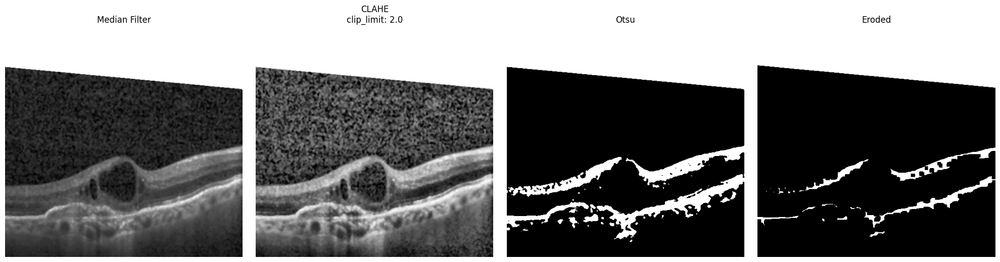

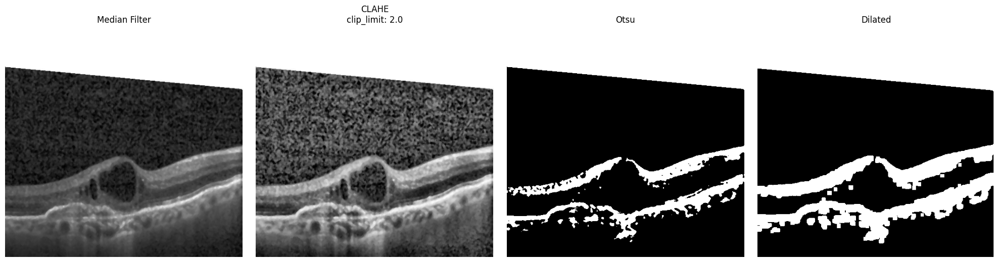

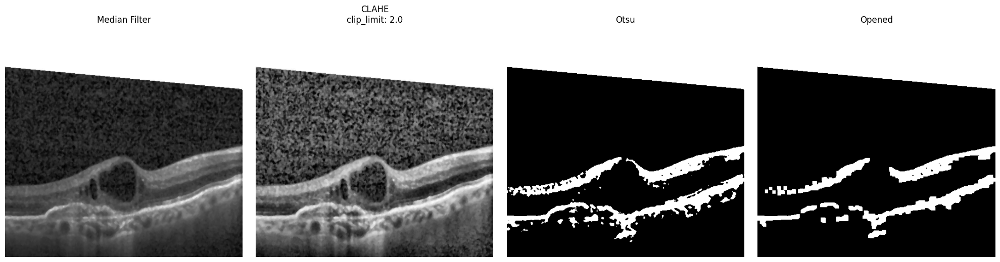

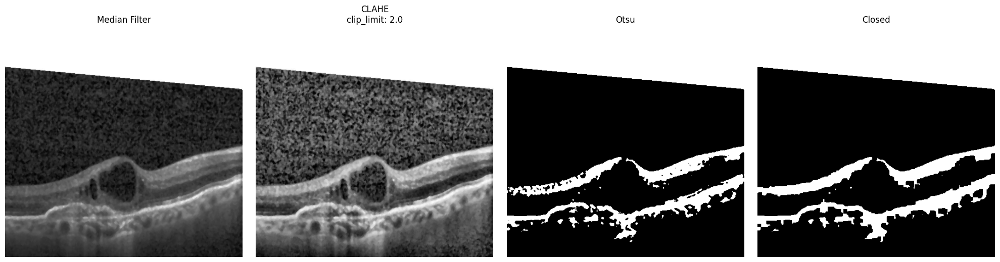

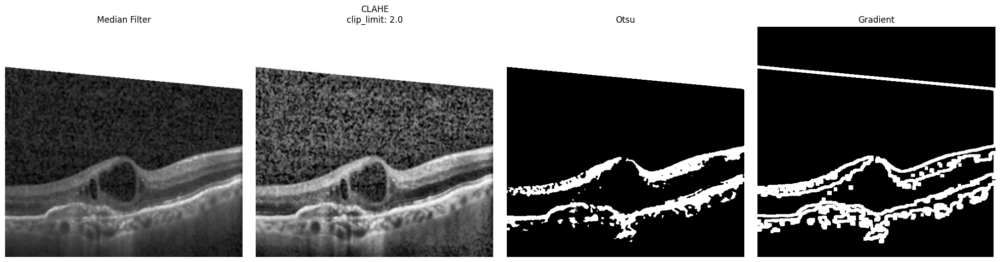

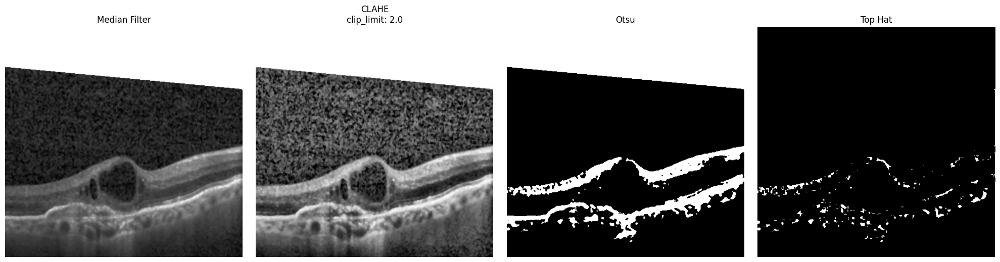

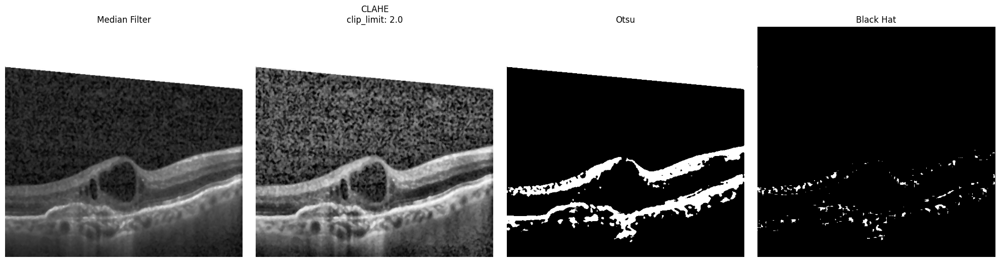

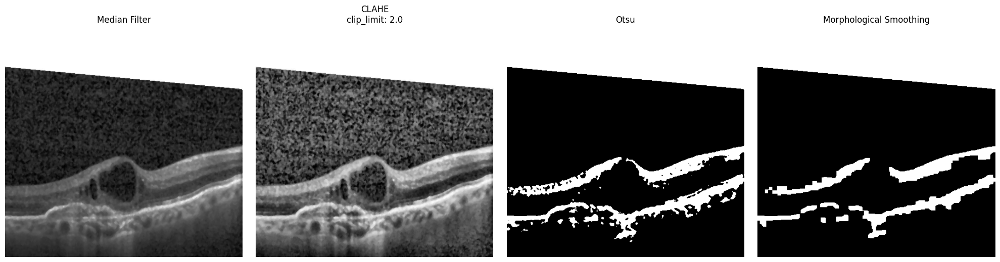

In [57]:
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (7, 7))
print(kernel)
for operation, op in operations.items():
    images, titles = pipe(
        img,
        clip_limit=2.0,
        morph={"type": op, "title": operation, "kernel": kernel},
    )
    plot_images(images, titles)

#### 9x9

[[1 1 1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1 1 1]]


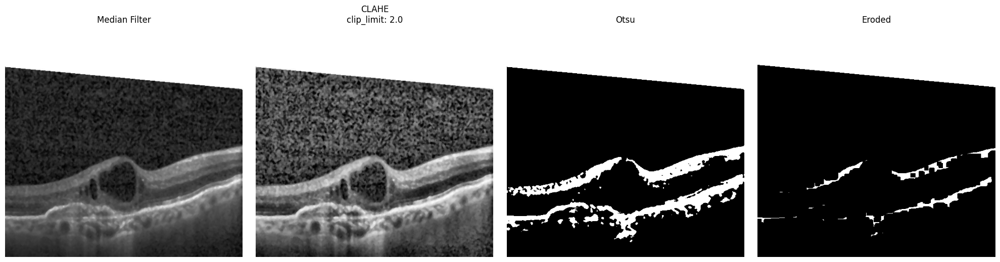

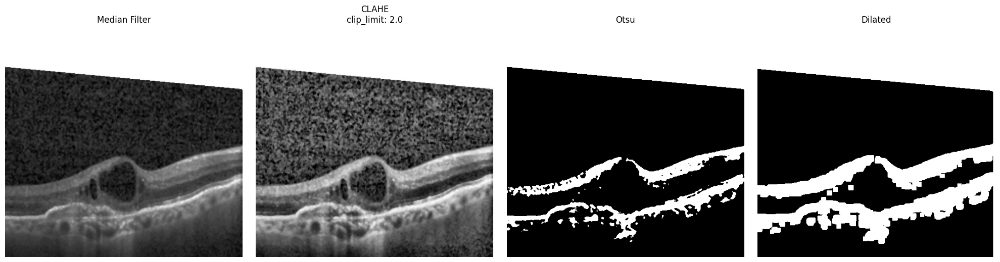

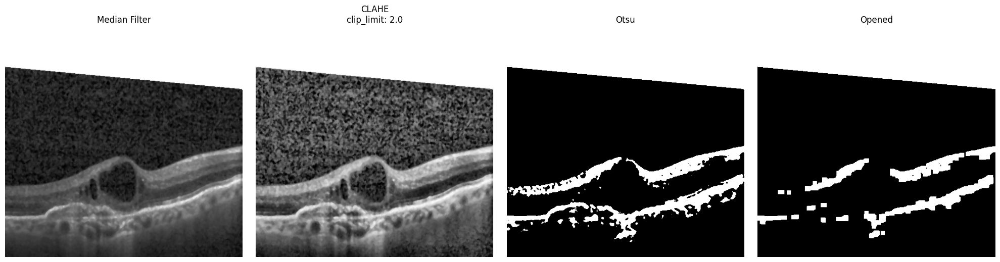

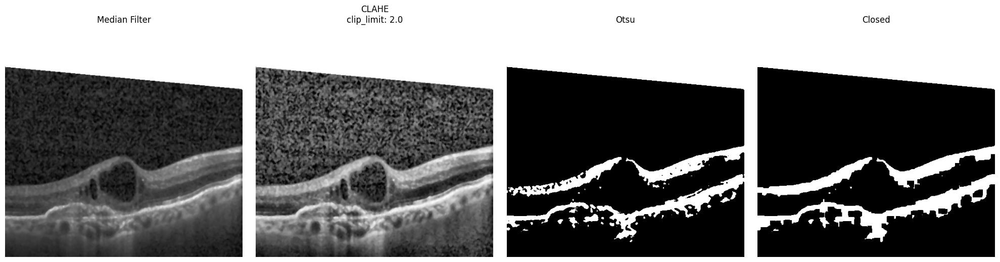

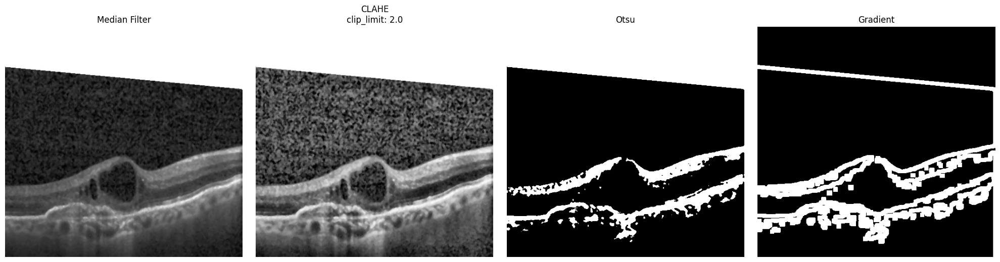

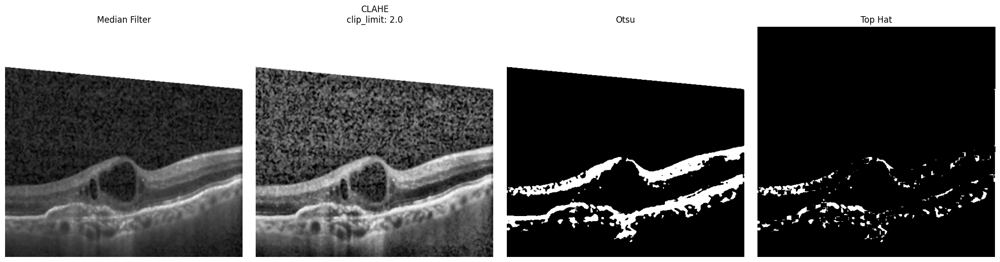

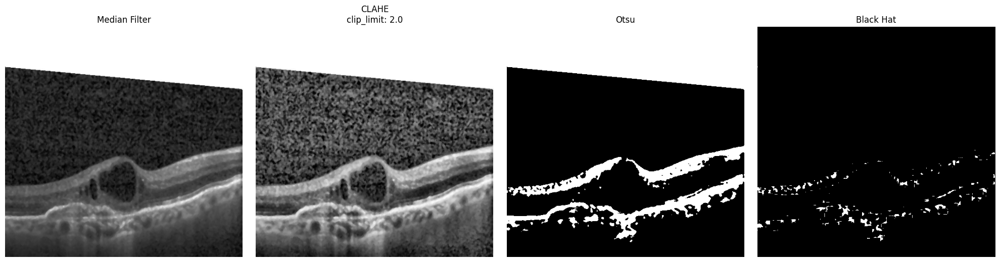

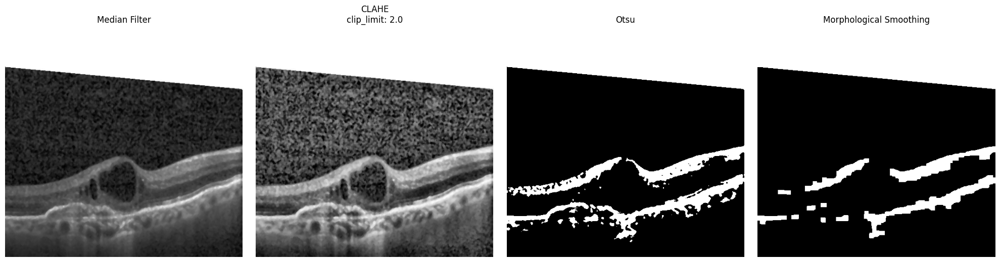

In [58]:
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (9, 9))
print(kernel)
for operation, op in operations.items():
    images, titles = pipe(
        img,
        clip_limit=2.0,
        morph={"type": op, "title": operation, "kernel": kernel},
    )
    plot_images(images, titles)

### ES: cv2.MORPH_ELLIPSE

#### 3x3

[[0 1 0]
 [1 1 1]
 [0 1 0]]


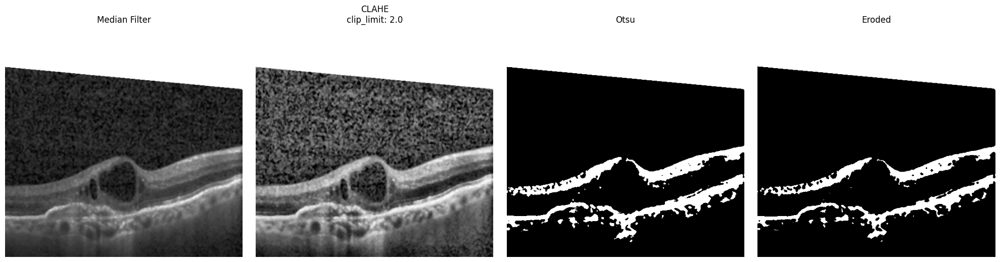

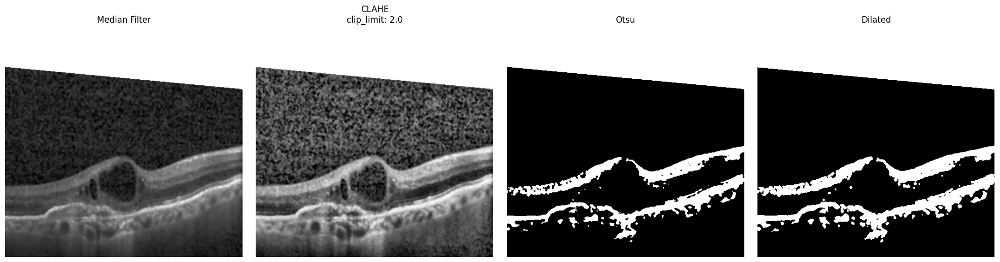

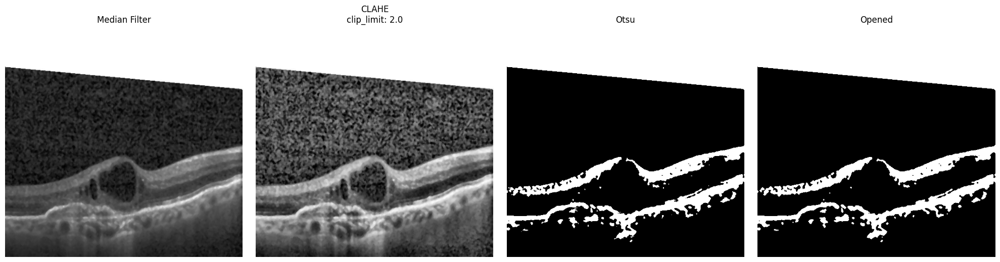

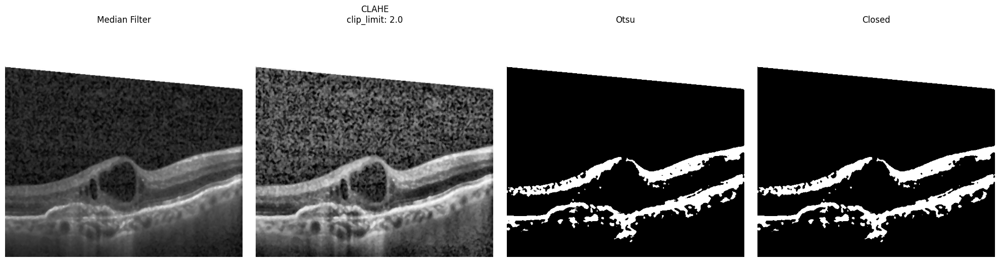

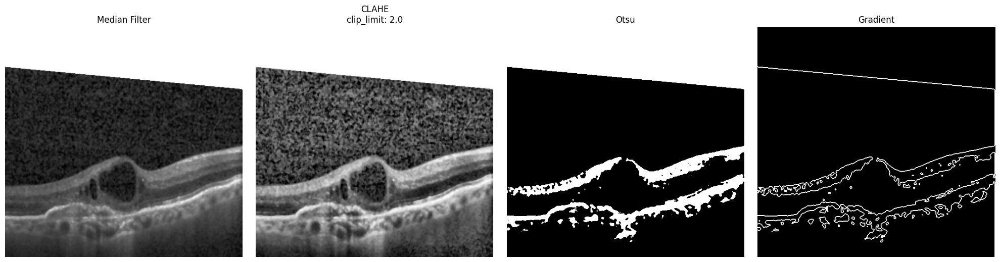

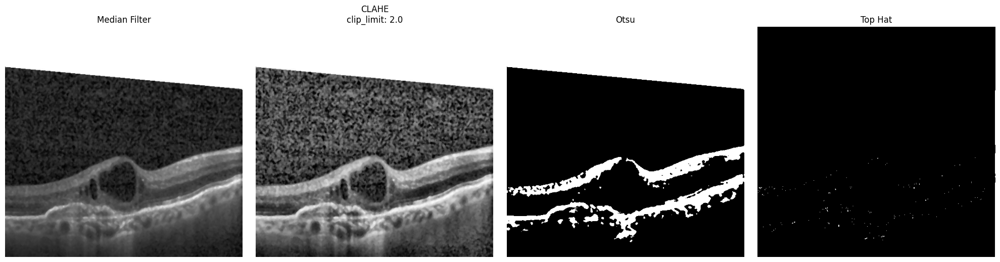

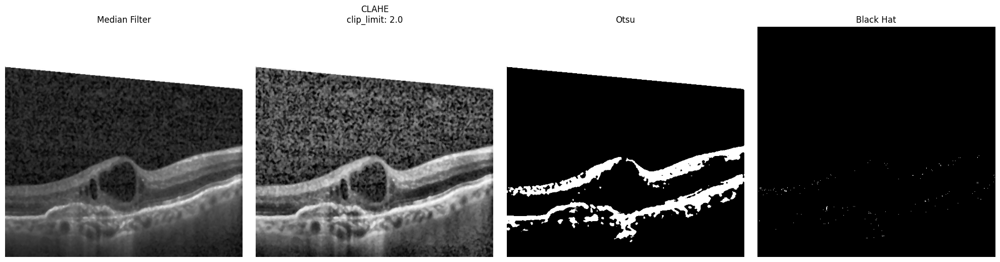

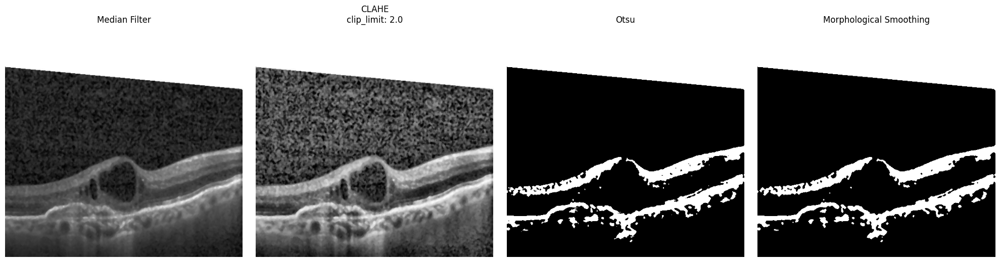

In [59]:
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
print(kernel)
for operation, op in operations.items():
    images, titles = pipe(
        img,
        clip_limit=2.0,
        morph={"type": op, "title": operation, "kernel": kernel},
    )
    plot_images(images, titles)

#### 5x5

[[0 0 1 0 0]
 [1 1 1 1 1]
 [1 1 1 1 1]
 [1 1 1 1 1]
 [0 0 1 0 0]]


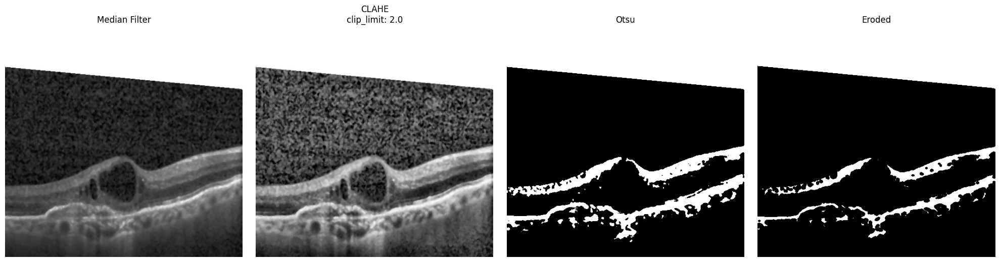

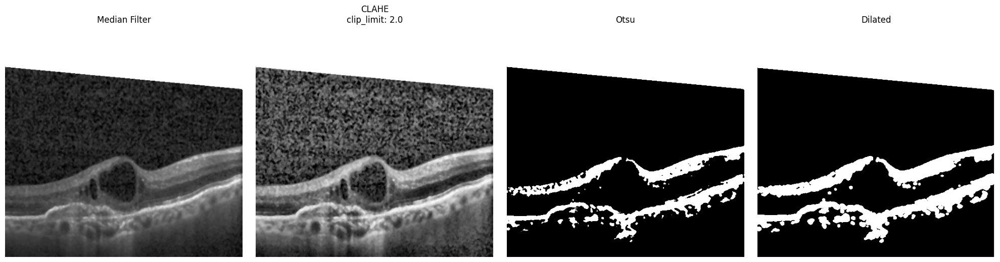

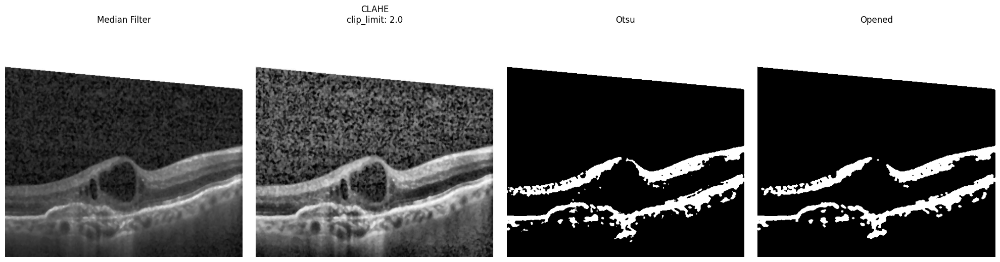

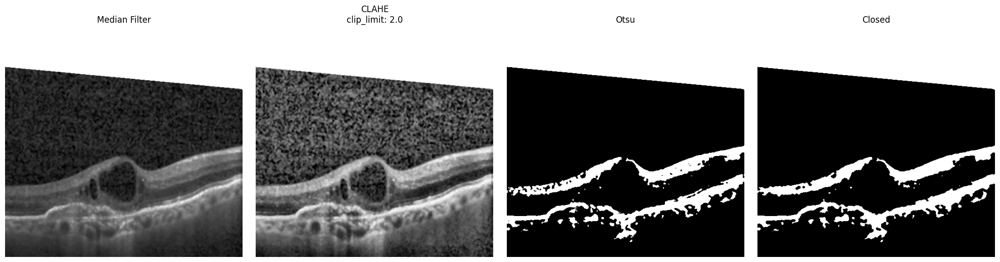

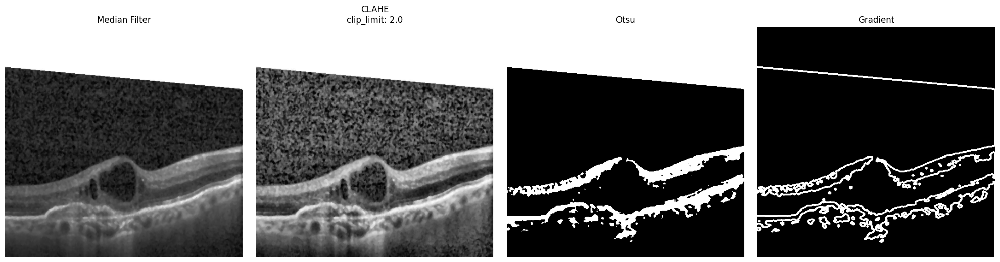

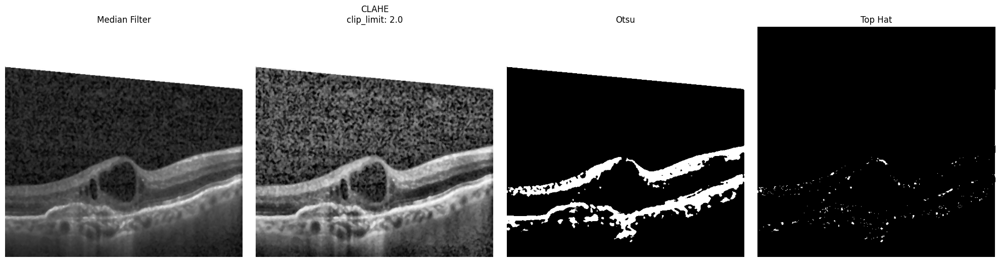

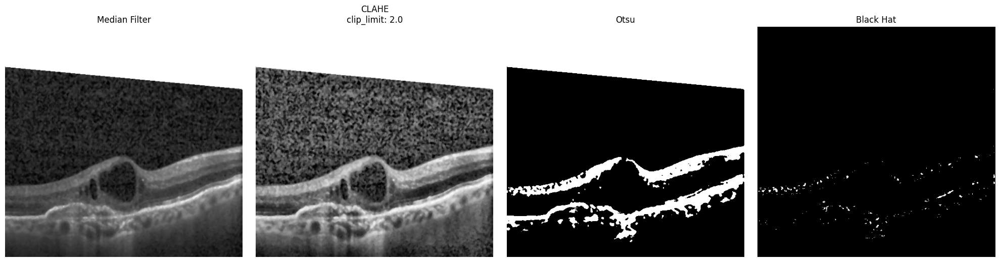

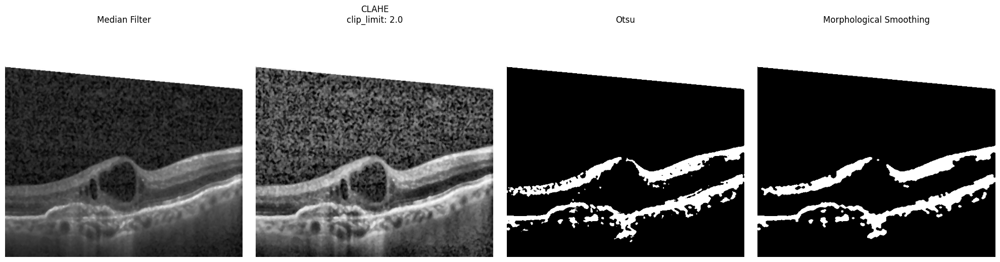

In [60]:
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
print(kernel)
for operation, op in operations.items():
    images, titles = pipe(
        img,
        clip_limit=2.0,
        morph={"type": op, "title": operation, "kernel": kernel},
    )
    plot_images(images, titles)

#### 7x7

[[0 0 0 1 0 0 0]
 [0 1 1 1 1 1 0]
 [1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1]
 [0 1 1 1 1 1 0]
 [0 0 0 1 0 0 0]]


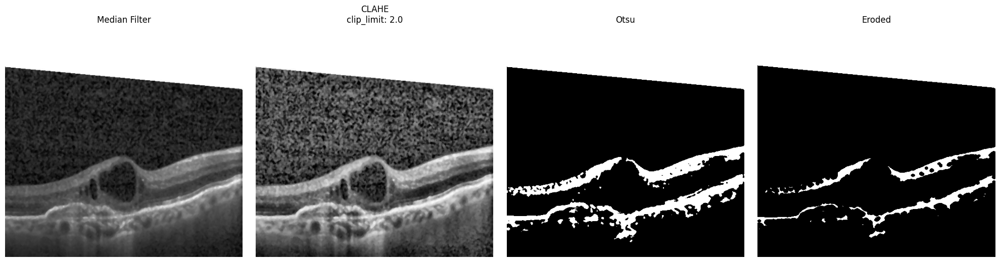

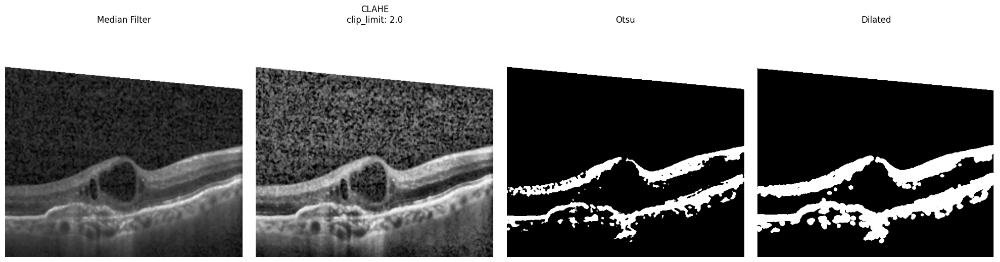

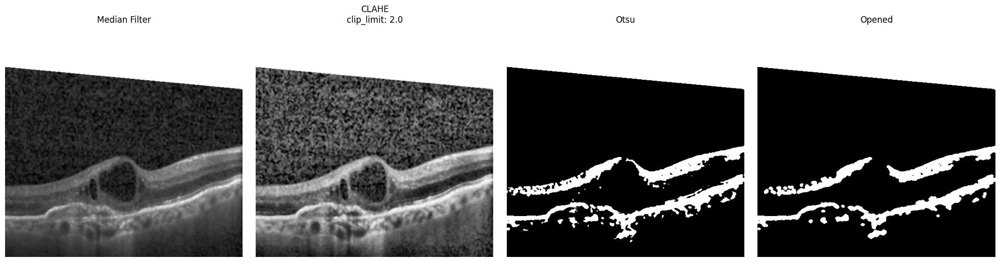

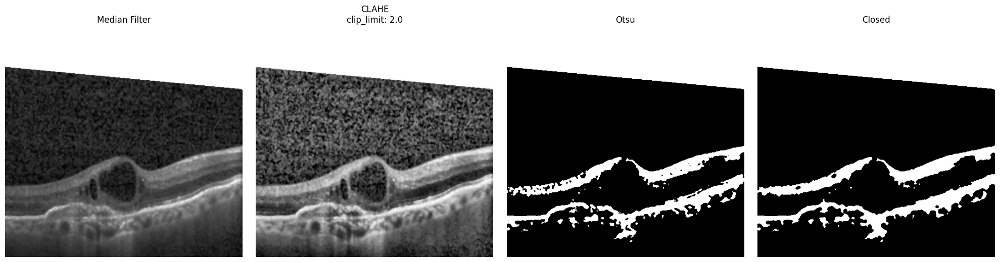

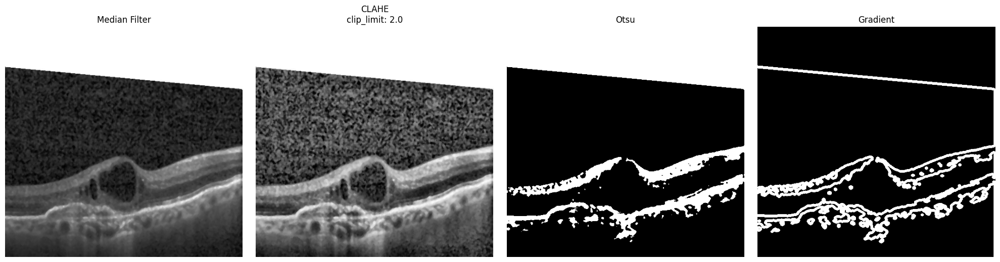

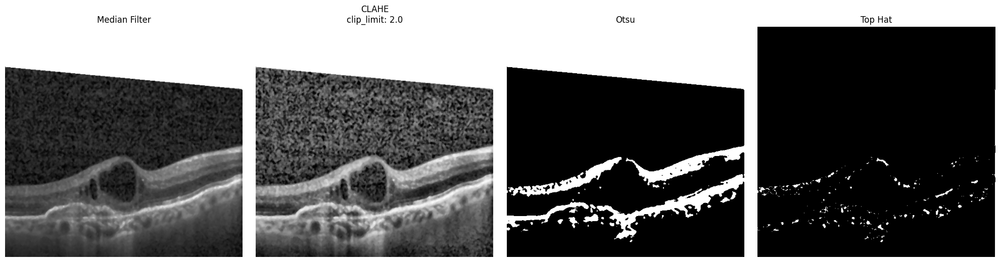

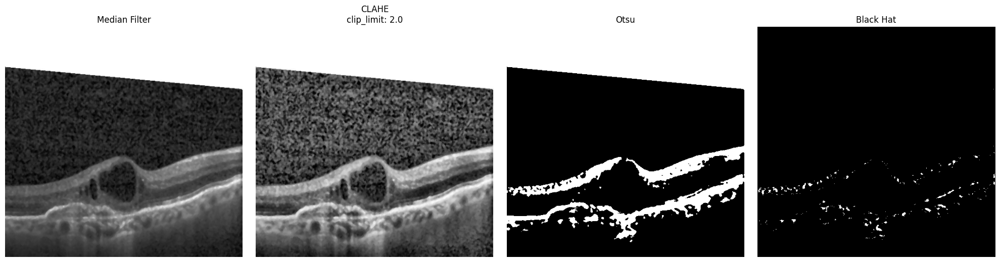

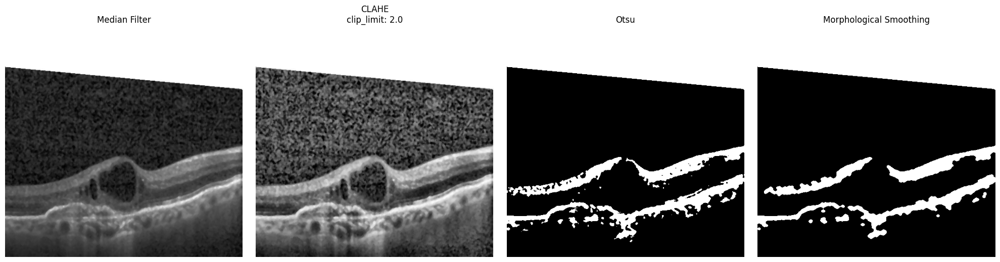

In [61]:
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (7, 7))
print(kernel)
for operation, op in operations.items():
    images, titles = pipe(
        img,
        clip_limit=2.0,
        morph={"type": op, "title": operation, "kernel": kernel},
    )
    plot_images(images, titles)

#### 9x9

[[0 0 0 0 1 0 0 0 0]
 [0 1 1 1 1 1 1 1 0]
 [0 1 1 1 1 1 1 1 0]
 [1 1 1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1 1 1]
 [0 1 1 1 1 1 1 1 0]
 [0 1 1 1 1 1 1 1 0]
 [0 0 0 0 1 0 0 0 0]]


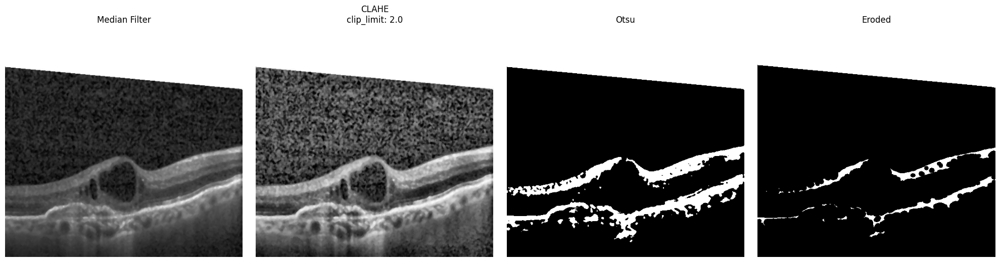

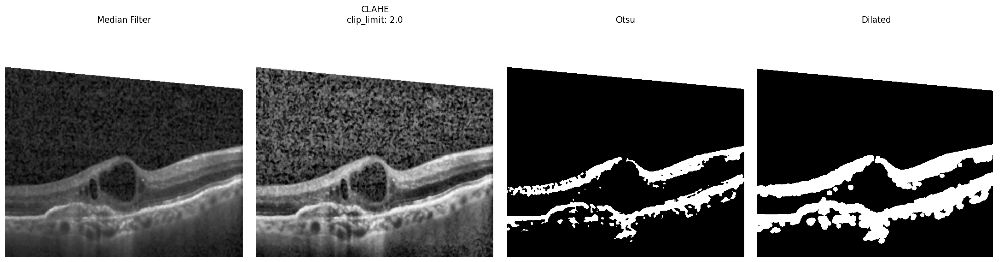

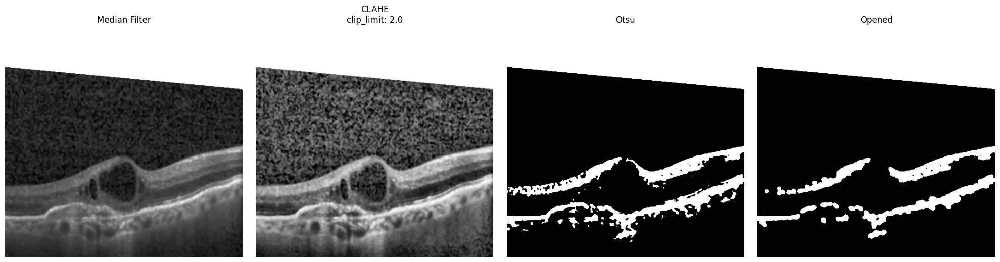

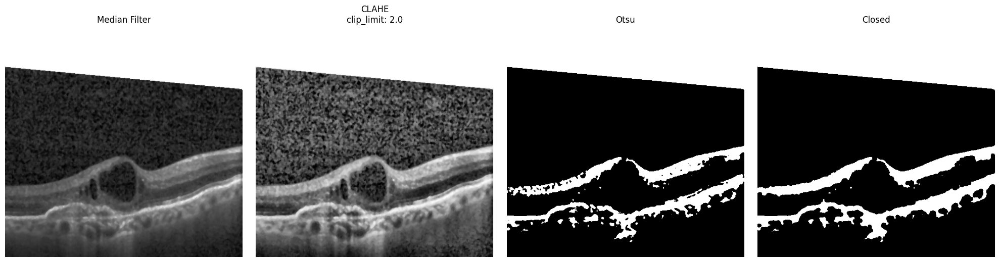

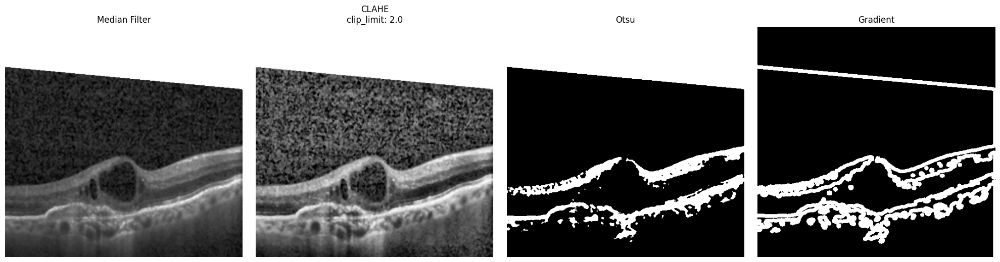

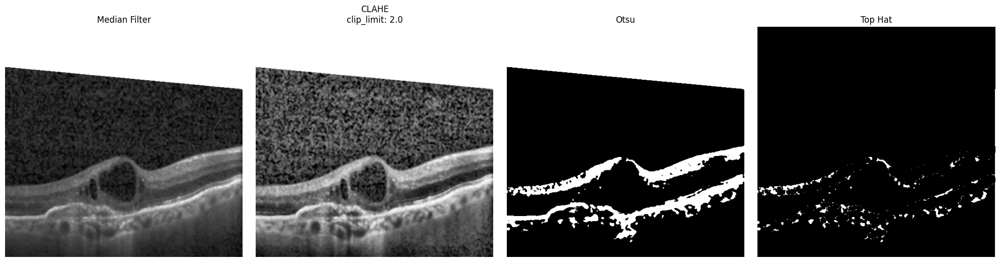

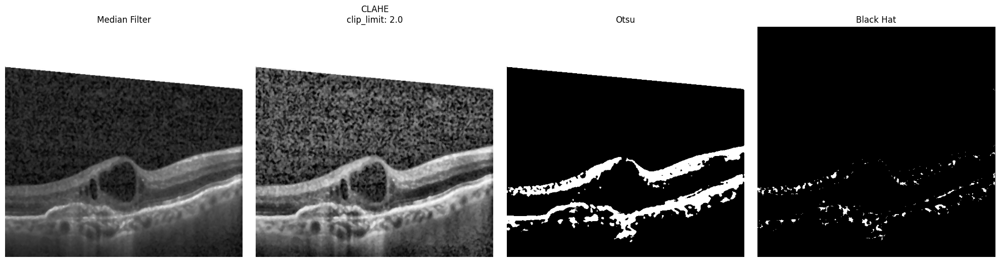

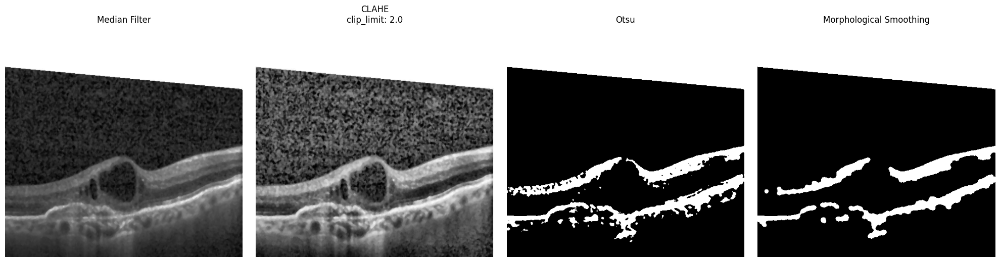

In [62]:
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (9, 9))
print(kernel)
for operation, op in operations.items():
    images, titles = pipe(
        img,
        clip_limit=2.0,
        morph={"type": op, "title": operation, "kernel": kernel},
    )
    plot_images(images, titles)

#### OBS: 

O artigo não diz qual foi a operação morfologica utilizada, porém ele diz que utiliza a a operação morfologica para suavizar ruídos. Logo, supomos que foi utilizado *Suavização Morfológica*.

Ele também não diz qual o elemento estruturante utilizado nem seu tamanho. Então escolhemos o elementro estruturante que, aparentemente, condiz mais com o contexto do problema e o tamanho que parece ter favorirecido uma segmentação melhor.

Por isso, utilizaremos Suavização morfologica(abertura seguida de fechamento) com elemento estruturante elíptico de tamanho 5x5.

## Extrair contornos para extrair bordas da camada da retina

##

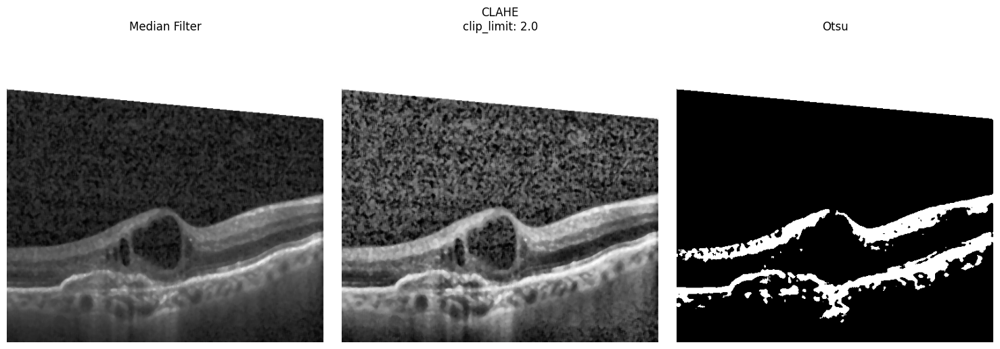

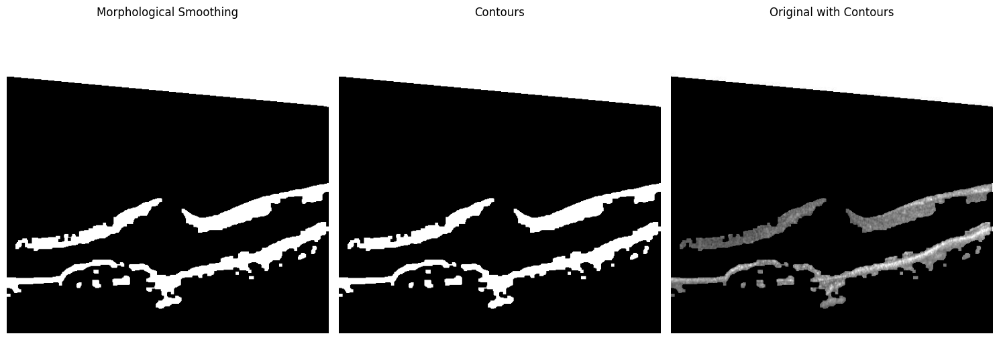

In [88]:
def draw_contours(image_bin: np.ndarray) -> np.ndarray:
    # Encontrar os contornos na imagem binária
    contours, _ = cv2.findContours(image_bin, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # Criar uma imagem de saída (do mesmo tamanho da imagem binária original) para desenhar os contornos
    image_with_contours = np.zeros_like(image_bin)  # Cria uma imagem preta do mesmo tamanho
    
    # Desenhar os contornos na imagem
    cv2.drawContours(image_with_contours, contours, -1, (255), thickness=cv2.FILLED)  # Contornos brancos em fundo preto
    
    return contours, image_with_contours


def pipe(image, clip_limit=2.0):
    images, titles = [], []
    image_orig = image.copy()

    image = median_filter(image)
    images.append(image.copy())
    titles.append("Median Filter")

    image = clahe(image, clip_limit=clip_limit)
    images.append(image.copy())
    titles.append(f"CLAHE\nclip_limit: {clip_limit}")

    image = otsu(image)
    images.append(image.copy())
    titles.append("Otsu")

    image = morphological_smoothing(np.array(image))
    images.append(image.copy())
    titles.append("Morphological Smoothing")
    
    # detectar contornos e desenhar
    contours, image = draw_contours(np.array(image))
    images.append(image.copy())
    titles.append("Contours")
    
    # aplicar a máscara dos contornos na imagem original
    image_orig = np.array(image_orig)
    image_orig[~image.astype(bool)] = 0
    images.append(image_orig.copy())
    titles.append("Original with Contours")
    
    return images, titles


images, titles = pipe(img, clip_limit=2.0)
m = len(images) // 2
plot_images(images[0:m], titles[0:m])
plot_images(images[m:], titles[m:])